# **Analysis for multiple trials**

## This analysis script is well suited to analyse your data from a protocol that consists of multiple trials, with different arenas and restboxes in between.

load modules

In [1]:
%load_ext autoreload

%autoreload 2
import numpy as np
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
from spikeA.Session import *
from spikeA.Spike_train_loader import Spike_train_loader
from spikeA.Cell_group import Cell_group
from spikeA.Animal_pose import Animal_pose
from spikeA.Session import Session

set session name

In [2]:
#name="pk1615-21012022-0109"  # five different environments in two different rooms
#name="pk3865-24012022-0109"  # five different environments in two different rooms
#name="pk3865-25012022-0105" # black-white-black in 55b
#name="pk3865-27012022-0109" # five env + good coverage, good MEC signal, ADN?
#name="pk3864-31012022-0109" # first 5 OF trials for pk3864
#name="pk3864-04022022-0109" # 
#name="pk3864-05022022-0109" # 
#name="pk3864-07022022-0109" # 
name="pk3864-09022022-0109" # 
#name="pk3864-14022022-0109"
#name="pk3864-15022022-0109"
#name="pk3864-17022022-0109"
# name="pk3864-22022022-0109"

Check the path

In [3]:
import os

basedir = "/adata/electro"
subject, session = name.split("-",1)
path = basedir+"/"+subject+"/"+name+"/"

fname = name.split("_")[0]

print("Path:", path)
print("Mouse:", subject) # directory = mouse subject name
print("Session:", session)
print("Name:", name, ",", fname)
print("")
print("Path:", "OK" if os.path.isdir(path) else "invalid")

Path: /adata/electro/pk3864/pk3864-09022022-0109/
Mouse: pk3864
Session: 09022022-0109
Name: pk3864-09022022-0109 , pk3864-09022022-0109

Path: OK


## Get a Session object

Check the files

In [4]:
ses = Kilosort_session(name=fname, path=path)
ses.load_parameters_from_files(ignore_params=True)  # ignore_params if kilosort has not been executed so far
print(ses)

<class 'spikeA.Session.Kilosort_session'>
name = pk3864-09022022-0109
path = /adata/electro/pk3864/pk3864-09022022-0109
subject = pk3864
session_dat_time = 2022-02-09 01:09:00
fileBase = /adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109
file_names = {'par': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.par', 'desen': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.desen', 'desel': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.desel', 'sampling_rate': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.sampling_rate_dat', 'stimulation': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.stimulation', 'px_per_cm': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.px_per_cm', 'setup': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.setup', 'environmentFamiliarity': '/adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.environmentFamiliarity', 'params':

### Trials

List all trials in that session with all information from the configuration files (setup, environment (box type: diameter, shape, color, cue card), familiarity).

In [5]:
print("all trials:\n")

for t,(tn,su,en,en_details,ef,iv) in enumerate(ses.session_trials()):
    print("#",t+1)
    print("trial:",tn)
    print("setup:",su)
    print("environment:",en)
    
    shape,diam,color,cue=en_details

    print("- Box type:",shape)
    print("- diameter:",diam)
    print("- color:",color)
    print("- cue:",cue)
    
    print("familiarity:",ef)
    print("duration:", round(iv[1]-iv[0]))
    print("")

all trials:

# 1
trial: pk3864-09022022_01
setup: 28B
environment: sqr-70_black_cue-W
- Box type: square
- diameter: 70.0
- color: black
- cue: cue-W
familiarity: fam
duration: 1419

# 2
trial: pk3864-09022022_02
setup: 28B
environment: rb
- Box type: rb
- diameter: 25.0
- color: None
- cue: None
familiarity: rb
duration: 101

# 3
trial: pk3864-09022022_03
setup: 28B
environment: sqr-70_white_cue-N
- Box type: square
- diameter: 70.0
- color: white
- cue: cue-N
familiarity: novel
duration: 1294

# 4
trial: pk3864-09022022_04
setup: 28B
environment: rb
- Box type: rb
- diameter: 25.0
- color: None
- cue: None
familiarity: rb
duration: 72

# 5
trial: pk3864-09022022_05
setup: 55B
environment: sqr-70_black_cue-E
- Box type: square
- diameter: 70.0
- color: black
- cue: cue-E
familiarity: novel
duration: 1205

# 6
trial: pk3864-09022022_06
setup: 55B
environment: rb
- Box type: rb
- diameter: 25.0
- color: None
- cue: None
familiarity: rb
duration: 128

# 7
trial: pk3864-09022022_07
setup:

## Load spikes

In [6]:
stl = Spike_train_loader()
stl.load_spike_train_kilosort(ses)
print("stl.clu_ids", ",", "len =", len(stl.clu_ids))
print(stl.clu_ids)
cg = Cell_group(stl)

stl.clu_ids , len = 36
[ 1  3  4  5 10 14 17 18 19 20 22 23 25 29 30 31 33 34 38 39 46 49 57 60
 66 74 75 76 77 79 81 85 90 91 92 93]


## Load the waveforms

Set the waveform and channel information from the session template file.

In [7]:
cg.set_info_from_session(ses, maxchannels=5)

Templates: 89 , timepoints: 82 , Channels: 64
Loaded templates-clusters-map, spikes: 3573966 , clusters: 85
Init shanks: 8


For each cluster, print the active channels where the spikes were detected, and the corresponding brain area.

In [8]:
unique, counts = np.unique([ '/'.join(n.brain_area) for n in cg.neuron_list ] , return_counts=True )

for u,c in zip(unique, counts):
    print(u,":",c)

adn : 24
mec : 12


## Create a pose file 

In [9]:
ap = Animal_pose(ses)
posefilename = ses.fileBase + ap.pose_file_extension
print("look for", posefilename)
if not os.path.exists(posefilename):
    print("load from positrack")
    extension = ap.positrack_type()
    print("use extension:",extension)
    ap.pose_from_positrack_files(ses=ses, interpolation_frequency_hz = 50, extension=extension)
    ap.save_pose_to_file() # save the file for next time
else:
    print("load from saved pose file")
    ap.load_pose_from_file()

look for /adata/electro/pk3864/pk3864-09022022-0109/pk3864-09022022-0109.pose.npy
load from saved pose file


In [10]:
ap.invalid_ratio()

0.08277477416017147

In [11]:
# find good shape automagically & crop
diameter=80.
xyrange_min,xyrange_max=ap.find_xy_range(diameter=diameter)  ###-> do this within intervals , for each trial + use min/max to find best square that covers most of the area
xmean,ymean = ap.meanloc
print("xmean,ymean",xmean,ymean)
print("xyrange_min,xyrange_max",xyrange_min,xyrange_max)

xmean,ymean 49.60506528158118 58.864975809992885
xyrange_min,xyrange_max [ 9.60506528 17.        ] [89.60506528 97.        ]


Plot the path of the animal to see if it was loaded correctly.

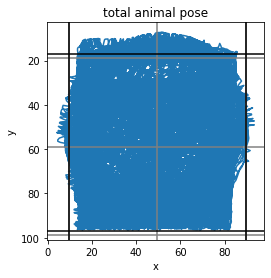

In [12]:
plt.plot(ap.pose[:,1],ap.pose[:,2])
plt.xlabel("x")
plt.ylabel("y")
#plt.scatter([xmean],[ymean], color="black", s=20)
plt.axvline(x=xmean, color="gray")
plt.axhline(y=ymean, color="gray")
plt.axvline(x=xmean+diameter/2, color="gray")
plt.axhline(y=ymean+diameter/2, color="gray")
plt.axvline(x=xmean-diameter/2, color="gray")
plt.axhline(y=ymean-diameter/2, color="gray")

plt.axvline(x=xyrange_min[0], color="black")
plt.axvline(x=xyrange_max[0], color="black")
plt.axhline(y=xyrange_min[1], color="black")
plt.axhline(y=xyrange_max[1], color="black")

plt.gca().invert_yaxis()
plt.gca().set_aspect('equal', adjustable='box')
plt.title("total animal pose")
plt.show()

Plot the occupancy map to see where the animal spent more or less time.

(The image seems mirrored since the x/y-axis for imshow is different compared to the plot function.)

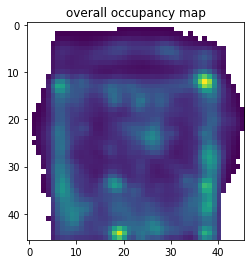

In [13]:
ap.occupancy_map_2d()
plt.imshow(ap.occupancy_map.T)
plt.title("overall occupancy map")
plt.show()

Plot the head-direction of the animal and its position a short segment.

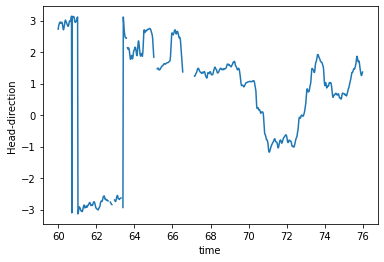

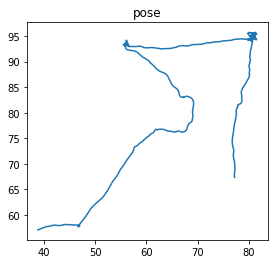

In [14]:
s=3000
e=3800

plt.plot(ap.pose[s:e,0], ap.pose[s:e,4])
plt.xlabel("time")
plt.ylabel("Head-direction")
plt.show()

plt.plot(ap.pose[s:e,1],ap.pose[s:e,2])
plt.gca().set_aspect('equal', adjustable='box')
plt.title("pose")
plt.show()

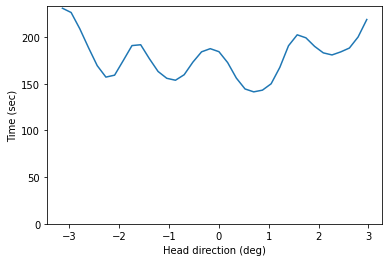

In [15]:
ap.head_direction_occupancy_histogram()
plt.plot(ap.hd_occupancy_bins[:-1],ap.hd_occupancy_histogram)
plt.ylim(0,np.max(ap.hd_occupancy_histogram)+2)
plt.ylabel("Time (sec)")
plt.xlabel("Head direction (deg)")
plt.show()

## **Summary:** Analysis for Trials

Now that we have all data from neurons and animal pose, set them together for further analysis.

Use only the `cg` or `n.spatial_properties` from now on.

In [16]:
print("number of trials:", ses.n_trials)
trials_in_environment = [ i for i,en in enumerate(ses.desen) if not en.startswith("rb") ]
trials_in_environment_number = len(trials_in_environment)
print("without restbox:", trials_in_environment_number)
session_trials = ses.session_trials()

number of trials: 9
without restbox: 5


Now we need to set the SpatialProperties object of each Neuron objects of the CellGroup.
Then we can get information score for each neuron from a firing rate map without smoothing.
We recalculate the maps with smoothing for display purposes.

In [17]:
cg.set_spatial_properties(ap)

Show a summary of all trials in that session with lots of information (skip restbox)

In [18]:
import matplotlib.patches as patches

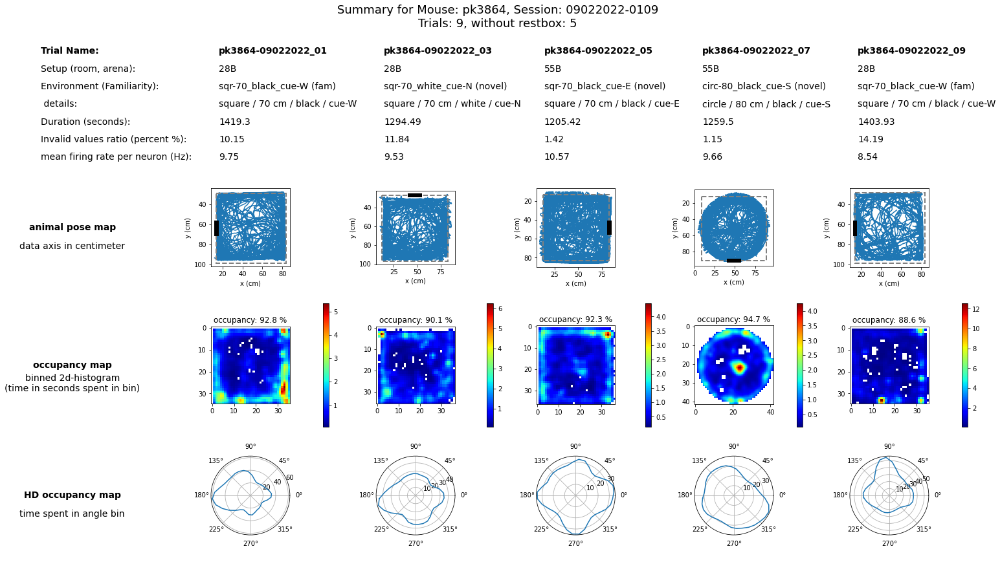

In [19]:
rows = 4
cols = trials_in_environment_number+1

fig, ax = plt.subplots(nrows=rows, ncols=cols, constrained_layout=True, figsize=(3.5*cols,3*rows))

plt.suptitle("Summary for Mouse: "+subject+", Session: "+session + "\n" +"Trials: "+str(ses.n_trials)+", without restbox: "+str(trials_in_environment_number) ,fontsize=18)
#plt.title()

# use this subplot only as grid for text
#ax[0,0].set_title("summary")
ax[0,0].axis("off")
ax[0,0].set_xlim([0, 10])
ax[0,0].set_ylim([0, 7])
ax[0,0].invert_yaxis()

ax[0,0].text(1.0,1.0, "Trial Name:", weight="bold", fontsize=14, verticalalignment="center")
for y,txt in enumerate(["Setup (room, arena)", "Environment (Familiarity)", " details", "Duration (seconds)", "Invalid values ratio (percent %)", "mean firing rate per neuron (Hz)"]):
    ax[0,0].text(1.0, 2+y, txt+":", fontsize=14, verticalalignment="center")

rows_description = [ ["animal pose map","data axis in centimeter"] , ["occupancy map", "binned 2d-histogram\n(time in seconds spent in bin)"], ["HD occupancy map", "time spent in angle bin"] ] 
for r,label in zip(np.arange(1,rows) , rows_description):
    #ax[r,0].set_title("occupancy map")
    ax[r,0].axis("off")
    ax[r,0].set_xlim([-1, 1])
    ax[r,0].set_ylim([-1, 1])
    ax[r,0].invert_yaxis()
    ax[r,0].text(0,0, label[0], weight="bold", fontsize=14, horizontalalignment="center", verticalalignment="center")
    ax[r,0].text(0,0.3, label[1], fontsize=14, horizontalalignment="center", verticalalignment="center")


i=1
for t,(tn,su,en,(shape,diam,color,cue),ef,iv) in enumerate(session_trials):
    # skip restbox
    if not t in trials_in_environment:
        continue
        
    # first row = desciption
    # use this subplot only as grid for text
    #ax[0,i].set_title(tn)
    ax[0,i].axis("off")
    ax[0,i].set_xlim([0, 10])
    ax[0,i].set_ylim([0, 7])
    ax[0,i].invert_yaxis()
    #ax[0,i].scatter([1],[1])
    

    ## restrict to trial = set appropriate interval
    ap.set_intervals(iv)
    cg.set_spatial_properties(ap) # apply these to all neurons
    # print(cg.mean_firing_rate_per_neuron()) # this can be now calculated for the specific trial
    # print(cg.neuron_list[0].spike_train.st)
    
    ax[0,i].text(1.0,1.0, tn, weight="bold", fontsize=14, verticalalignment="center")
    for y,txt in enumerate([su, en+" ("+ef+")", ' / '.join([shape,str(round(diam))+' cm',str(color),str(cue)]), np.round(iv[1]-iv[0],2) , np.round(100.*ap.invalid_ratio(),2) , np.round(cg.mean_firing_rate_per_neuron(),2) ]):
        ax[0,i].text(1.0, 2+y, txt, fontsize=14, verticalalignment="center")
    
    
    
    ## draw animal's pose, and automagically detected square
    ax[1,i].plot(ap.pose[:,1],ap.pose[:,2])
    
    ax[1,i].set_aspect('equal', adjustable='box')
    #ax[1,i].axis('scaled')
    #ax[1,i].autoscale()
    
    xyrange_min,xyrange_max = ap.find_xy_range(diameter = diam)
    # print("meanloc",ap.meanloc)
    # print("poserect",ap.poserect)

    # draw the Rectangle (pose xy_range), and add it as patch to the Axes
    rect = patches.Rectangle((xyrange_min[0], xyrange_min[1]), diam, diam, linewidth=2, edgecolor='gray', ls="dashed", fill=False, facecolor='none', zorder=4)
    ax[1,i].add_patch(rect)
    
    # draw the cue card
    cue = cue.split('-')
    if len(cue)>1:
        cue = cue[1]
    else:
        cue = cue[0]
    
    cuelen = diam/5.
    cuewidth = 3.
    
    cardinal_direction = {
        'N':((xyrange_min[0]+diam/2.-cuelen/2., xyrange_min[1]-cuewidth/2.) , cuelen, cuewidth),
        'S':((xyrange_min[0]+diam/2.-cuelen/2., xyrange_max[1]-cuewidth/2.) , cuelen, cuewidth),
        'W':((xyrange_min[0]-cuewidth/2., xyrange_min[1]+diam/2.-cuelen/2.) , cuewidth, cuelen),
        'E':((xyrange_max[0]-cuewidth/2., xyrange_min[1]+diam/2.-cuelen/2.) , cuewidth, cuelen)
    }
    cue_coords = cardinal_direction.get(cue, False)
    if cue_coords:
        (x0,y0),width,height = cue_coords
        rect = patches.Rectangle((x0,y0), width, height, linewidth=2, edgecolor='black', facecolor='black', fill=True, zorder=5)
        ax[1,i].add_patch(rect)
    
    # y is increasing south, like in imshow
    ax[1,i].invert_yaxis()
    
    #ax[1,i].axis('off')
    ax[1,i].set_xlabel("x (cm)")
    ax[1,i].set_ylabel("y (cm)")
    
    
    ## occupancy map
    ap.invalid_outside_spatial_area(shape=shape, radius=diam/2., length=diam, center=np.mean([xyrange_min,xyrange_max],axis=0))
    ap.occupancy_map_2d() 
    im = ax[2,i].imshow(ap.occupancy_map.T, cmap='jet')#, origin="lower")
    #ax[2,i].plot([1,2,3],[5,5,7])
    c = fig.colorbar(im,ax=ax[2,i], pad=-0.3)
    #im.set_clim(0, 0.5)
    #maxocc=[None]*trials_in_environment_number , collect to normalize all together with same colorbar
    # print(np.nanmax(ap.occupancy_map))
    occupancy = ap.occupancy(arena=shape)
    ax[2,i].set_title("occupancy: {:.1f} %".format(occupancy*100))
    
    ## HD occupancy map
    ap.head_direction_occupancy_histogram()  # calculate HD occ map
    angles = ap.mid_point_from_edges(ap.hd_occupancy_bins) # get mid angles from histogram edges
    #ax[3,i].set_ylim(0,np.max(ap.hd_occupancy_histogram)*1.2)
    # make polar plot (radius = time spent in that HD bin)
    ax[3,i].axis('off')
    ax2 = fig.add_subplot(rows, cols, cols*3+i+1, polar=True)
    #ax2.plot(angles, ap.hd_occupancy_histogram)
    ax2.plot(np.append(angles,angles[0]), np.append(ap.hd_occupancy_histogram,ap.hd_occupancy_histogram[0]))
    ax2.grid(True)
    
    i+=1
    
#plt.subplots_adjust(wspace=0.1, hspace=0.3, top=.85)
#fig.set_constrained_layout_pads(w_pad=4./72., h_pad=4./72., hspace=0./72., wspace=0./72.)

# plt.savefig('/home/pascal/Documents/science_docs/analysis_results/'+name+'_summary.pdf')
plt.show()

## Analysis for all neurons

In [26]:
# https://matplotlib.org/stable/gallery/subplots_axes_and_figures/gridspec_nested.html
import matplotlib.backends.backend_pdf
from tqdm import tqdm
import matplotlib.gridspec as gridspec

In [27]:
# https://stackoverflow.com/a/33505522

from mpl_toolkits import axes_grid1

def add_colorbar(im, aspect=20, pad_fraction=0.5, **kwargs):
    """Add a vertical color bar to an image plot."""
    divider = axes_grid1.make_axes_locatable(im.axes)
    width = axes_grid1.axes_size.AxesY(im.axes, aspect=1./aspect)
    pad = axes_grid1.axes_size.Fraction(pad_fraction, width)
    current_ax = plt.gca()
    cax = divider.append_axes("right", size=width, pad=pad)
    plt.sca(current_ax)
    return im.axes.figure.colorbar(im, cax=cax, **kwargs)

In [28]:
hd_cells_all = []   # list: is HD cell (bool)
grid_cells_all = [] # list: is grid cell (bool)

hd_angles_all = [] # list: mean direction angle

firing_rate_maps_all = [] # list: firing rate maps
grid_rotations_all = [] # list: autocorrelation hexagon rotation (derived from firing rate map -> autocorrelation map -> hexagon)


  0%|                                                    | 0/36 [00:00<?, ?it/s]

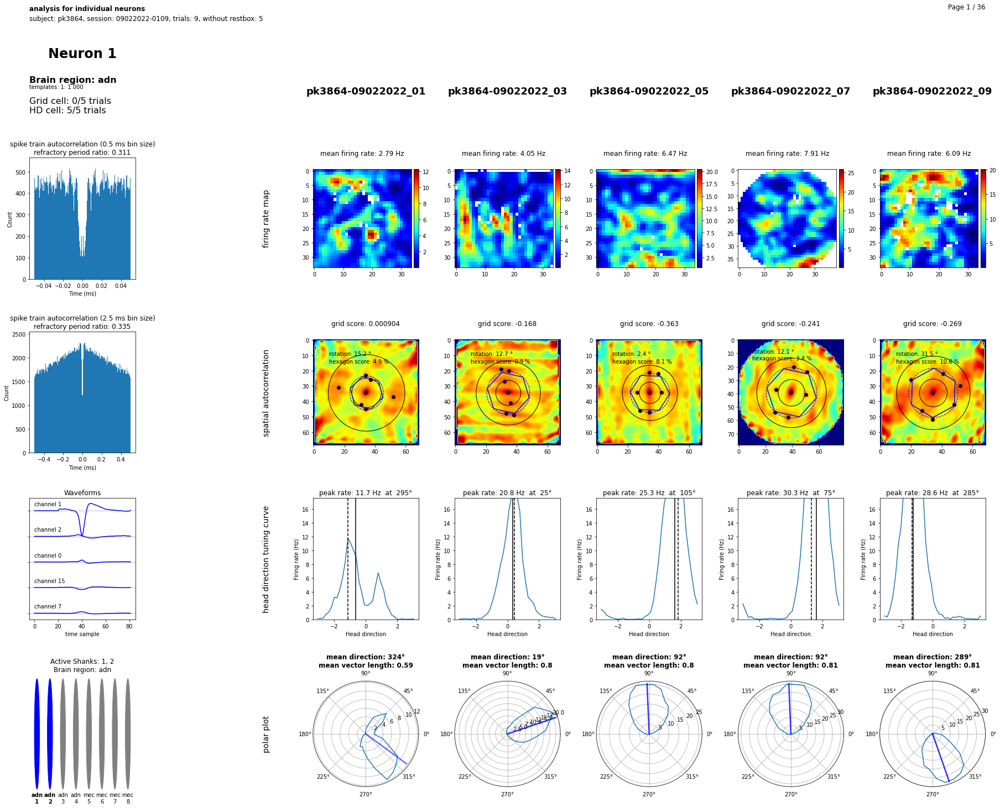

  3%|█▏                                          | 1/36 [00:11<06:42, 11.51s/it]

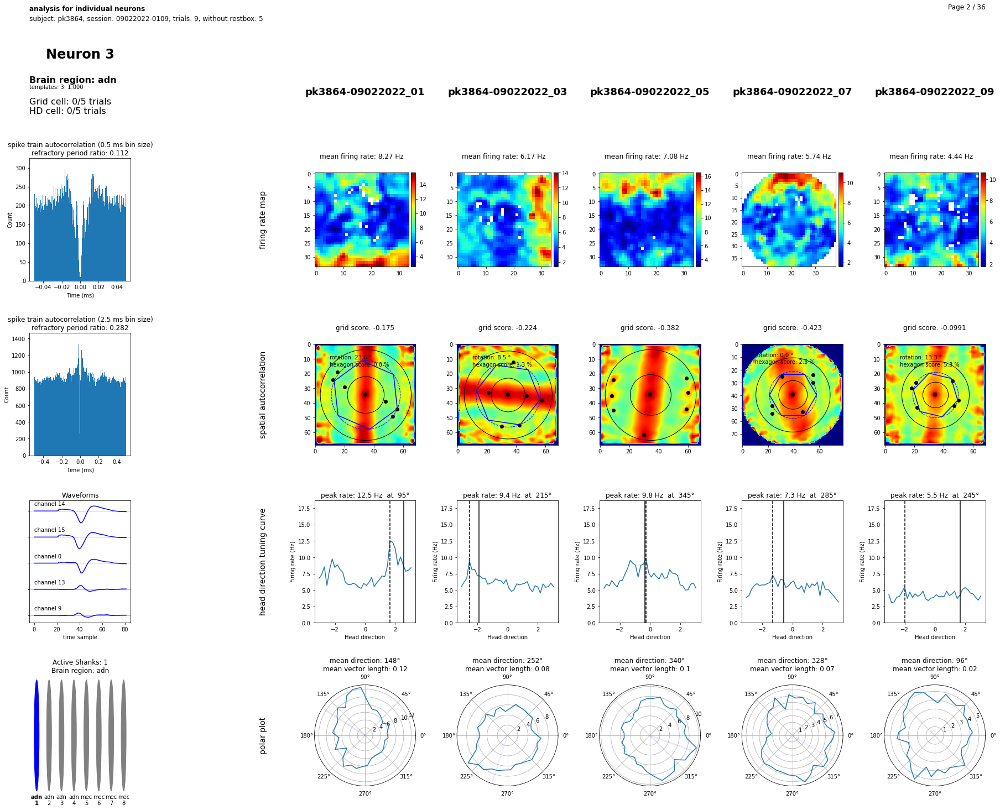

  6%|██▍                                         | 2/36 [00:22<06:29, 11.47s/it]

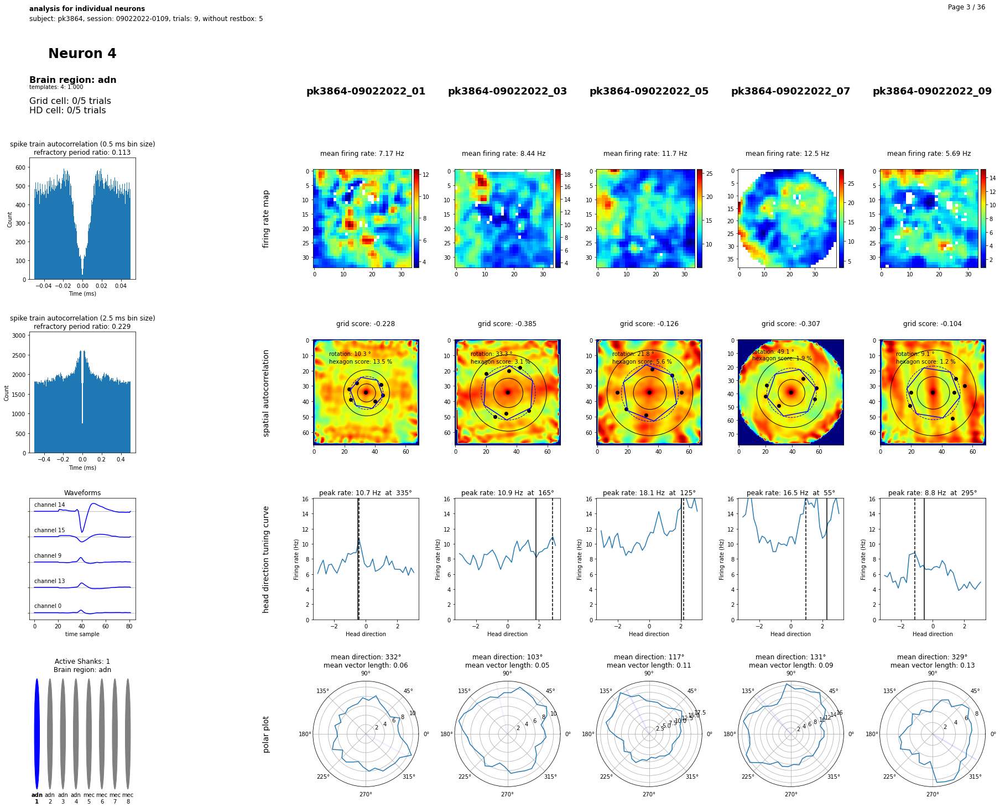

  8%|███▋                                        | 3/36 [00:34<06:19, 11.49s/it]

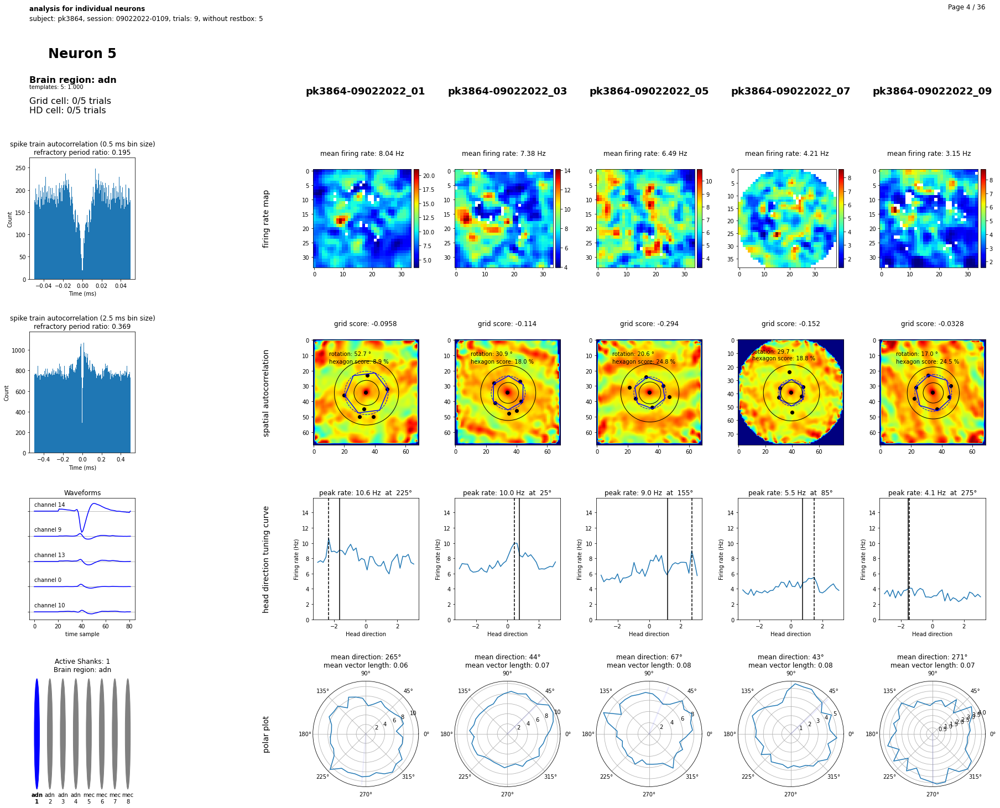

 11%|████▉                                       | 4/36 [00:46<06:12, 11.64s/it]

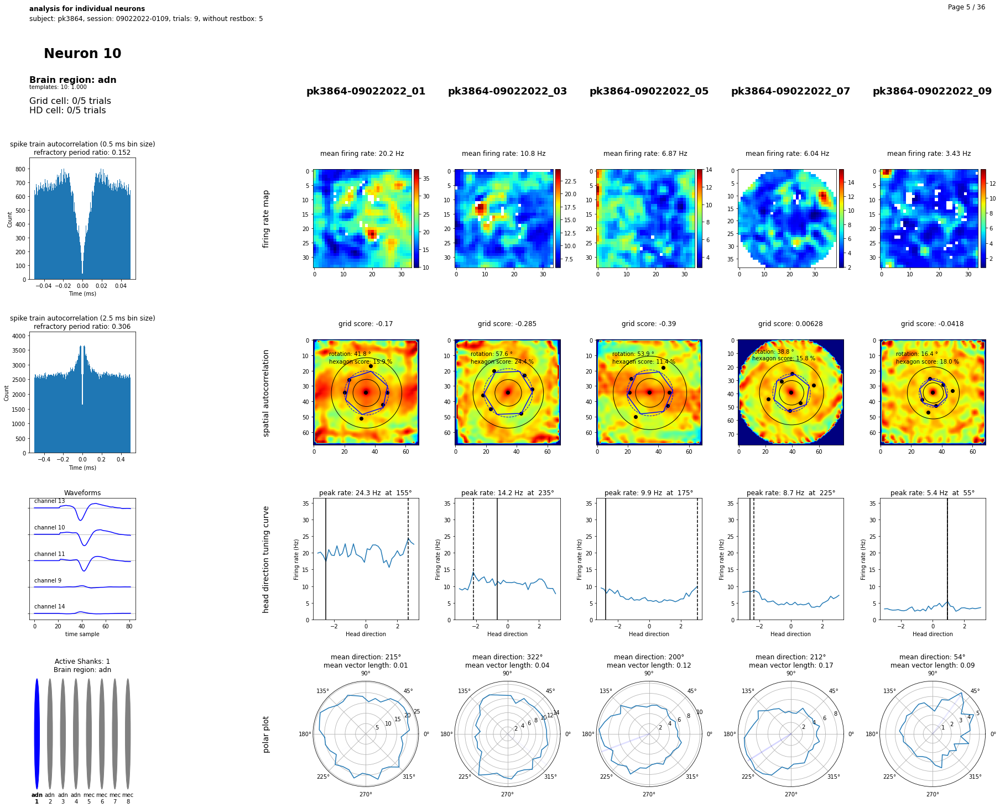

 14%|██████                                      | 5/36 [00:57<05:59, 11.61s/it]

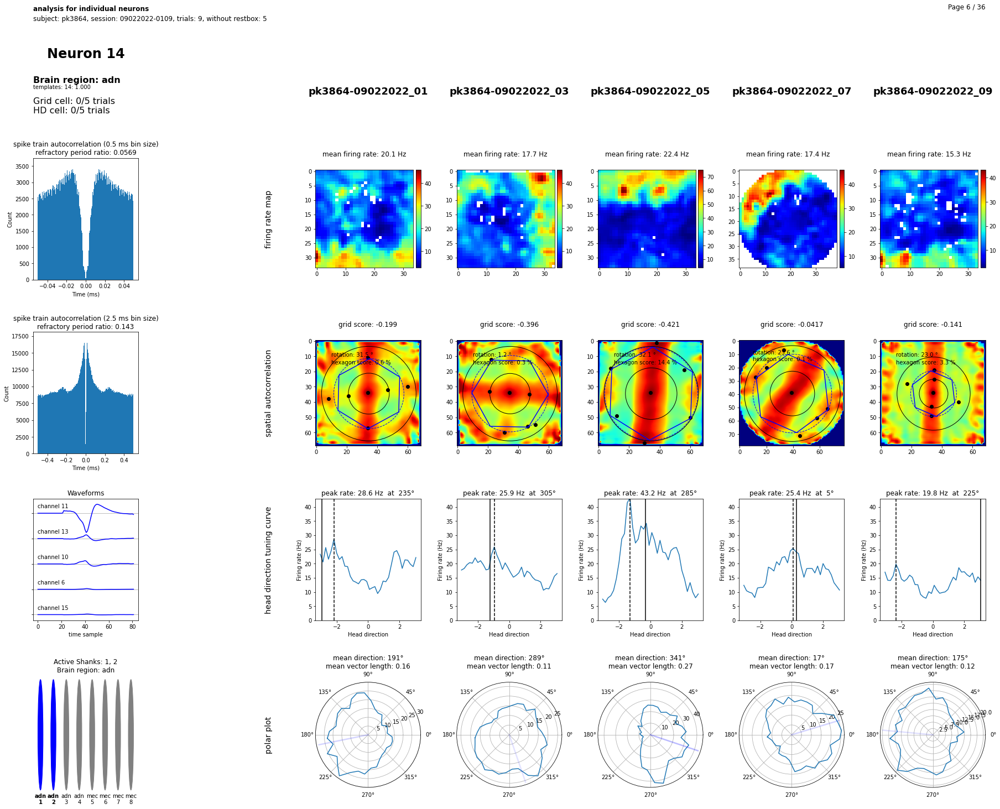

 17%|███████▎                                    | 6/36 [01:09<05:48, 11.61s/it]

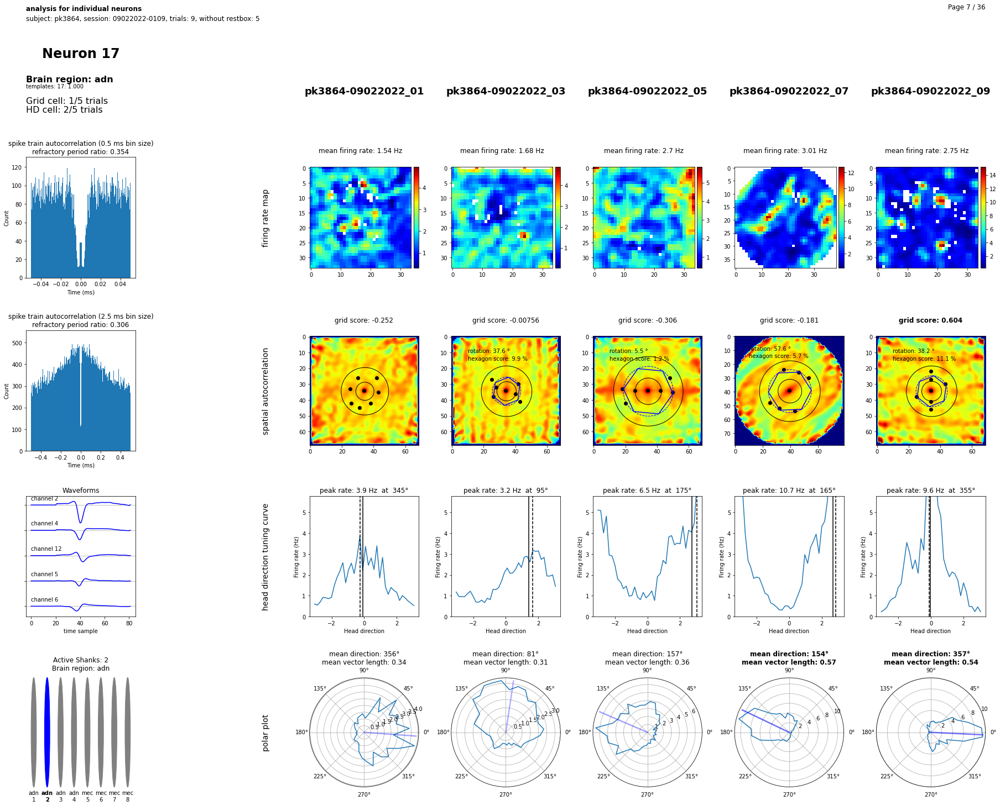

 19%|████████▌                                   | 7/36 [01:20<05:32, 11.46s/it]

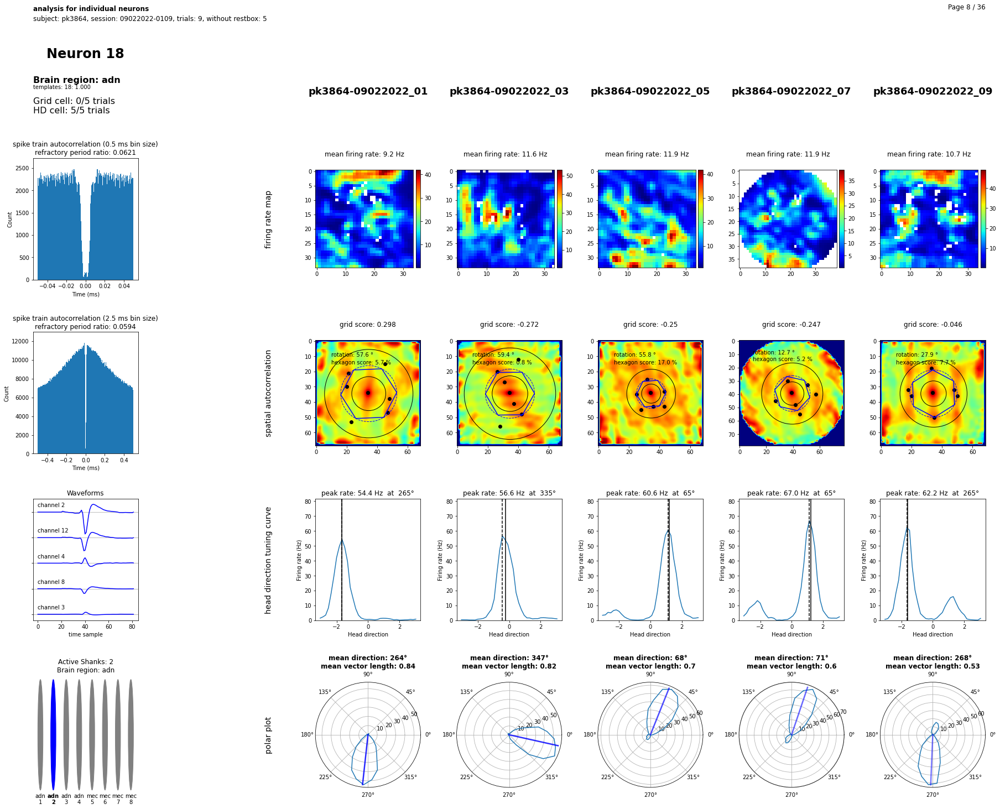

 22%|█████████▊                                  | 8/36 [01:31<05:19, 11.40s/it]

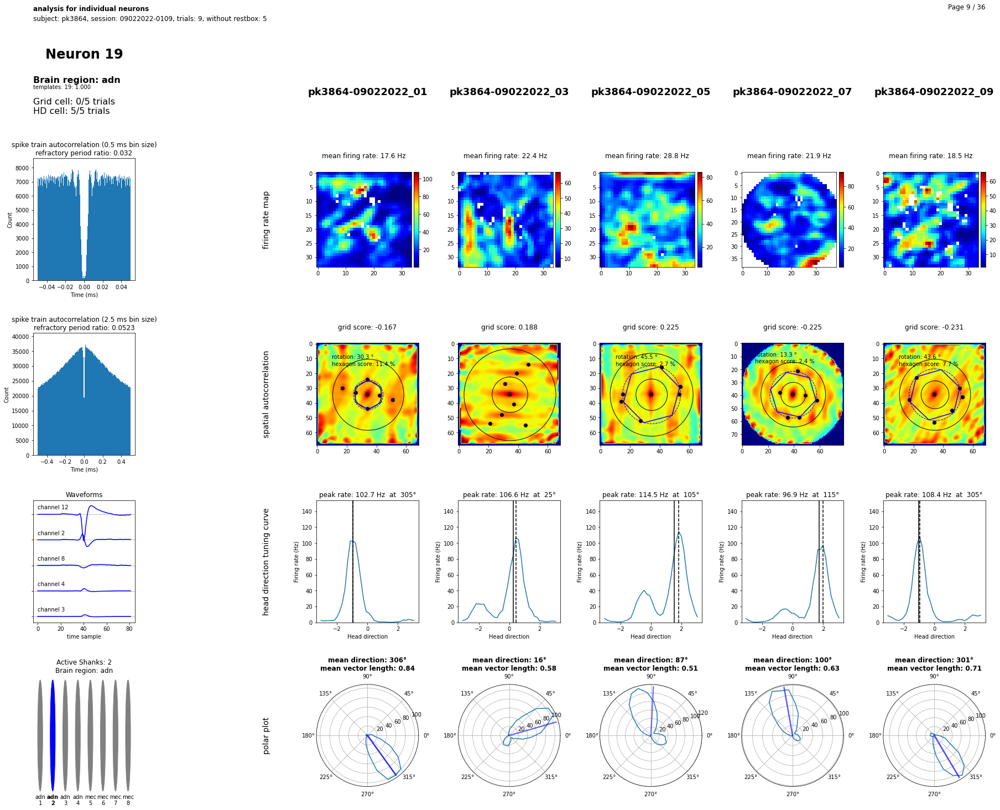

 25%|███████████                                 | 9/36 [01:43<05:08, 11.42s/it]

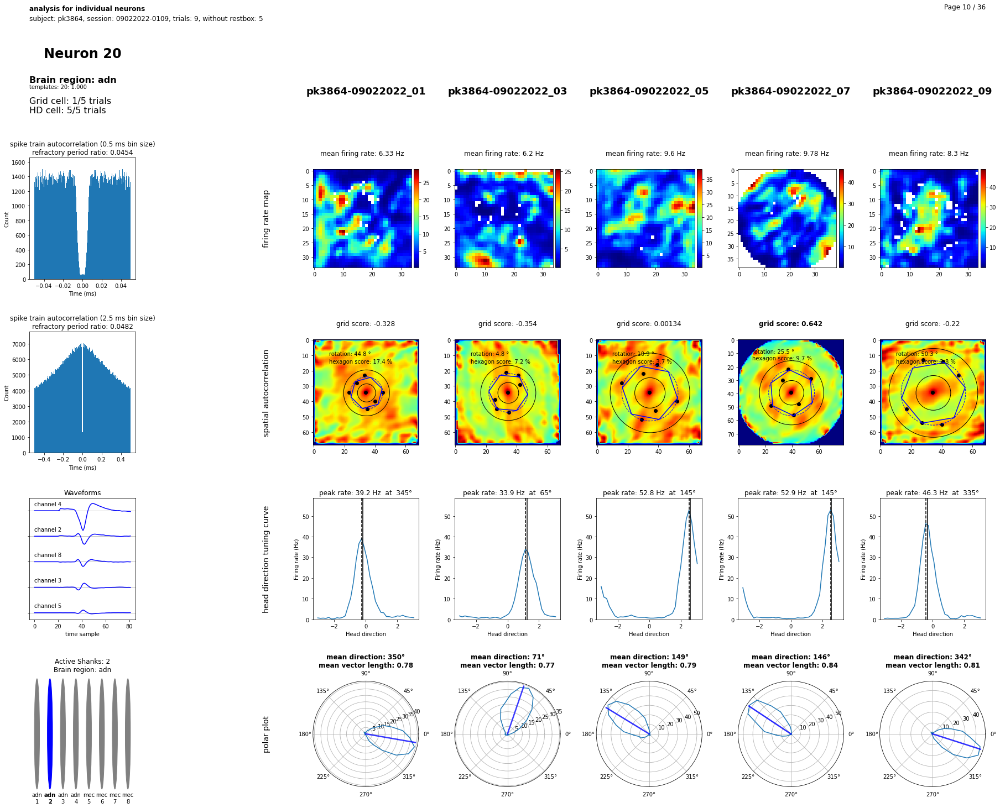

 28%|███████████▉                               | 10/36 [01:54<04:54, 11.34s/it]

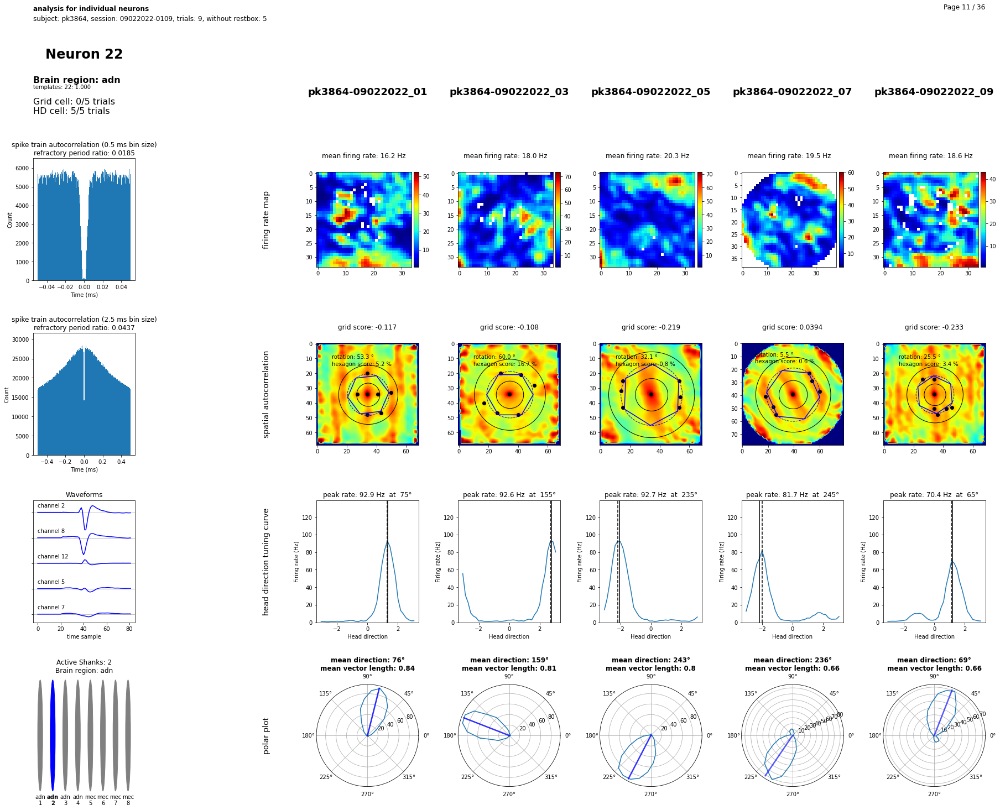

 31%|█████████████▏                             | 11/36 [02:06<04:45, 11.41s/it]

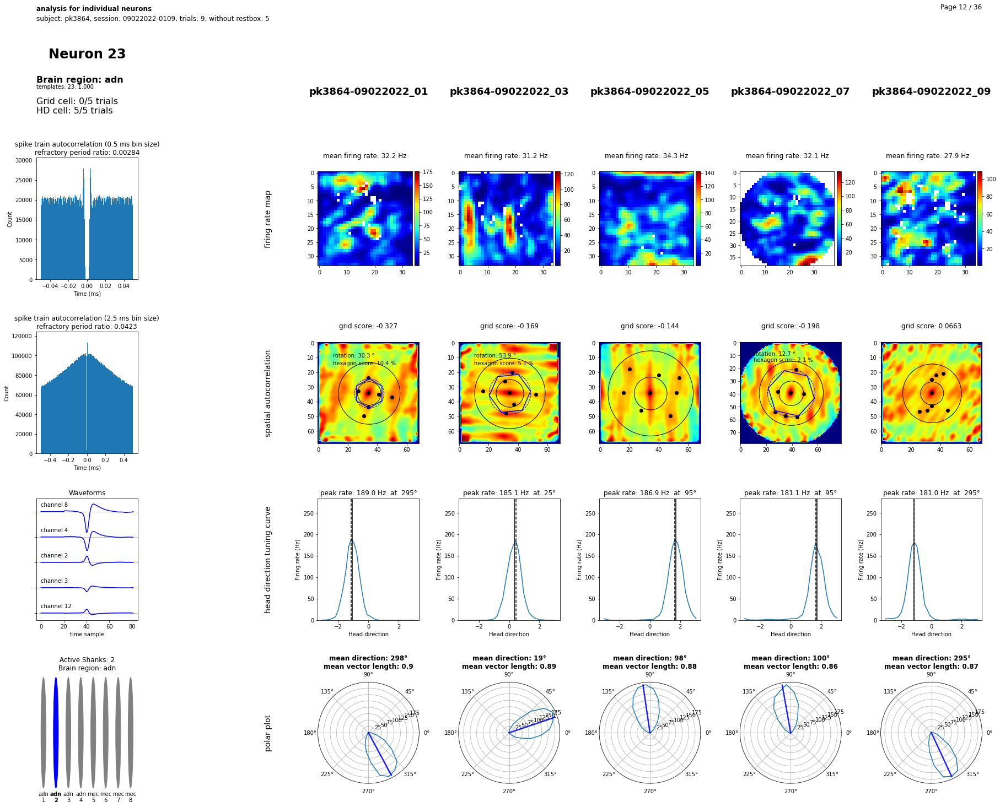

 33%|██████████████▎                            | 12/36 [02:17<04:37, 11.55s/it]

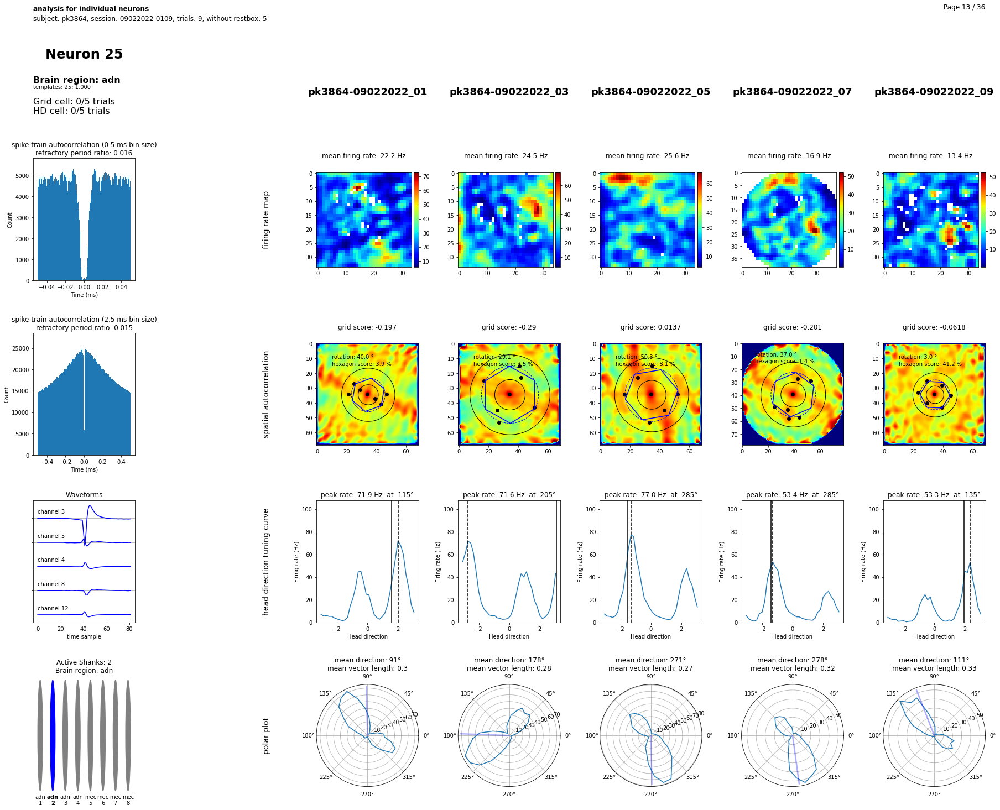

 36%|███████████████▌                           | 13/36 [02:29<04:26, 11.59s/it]

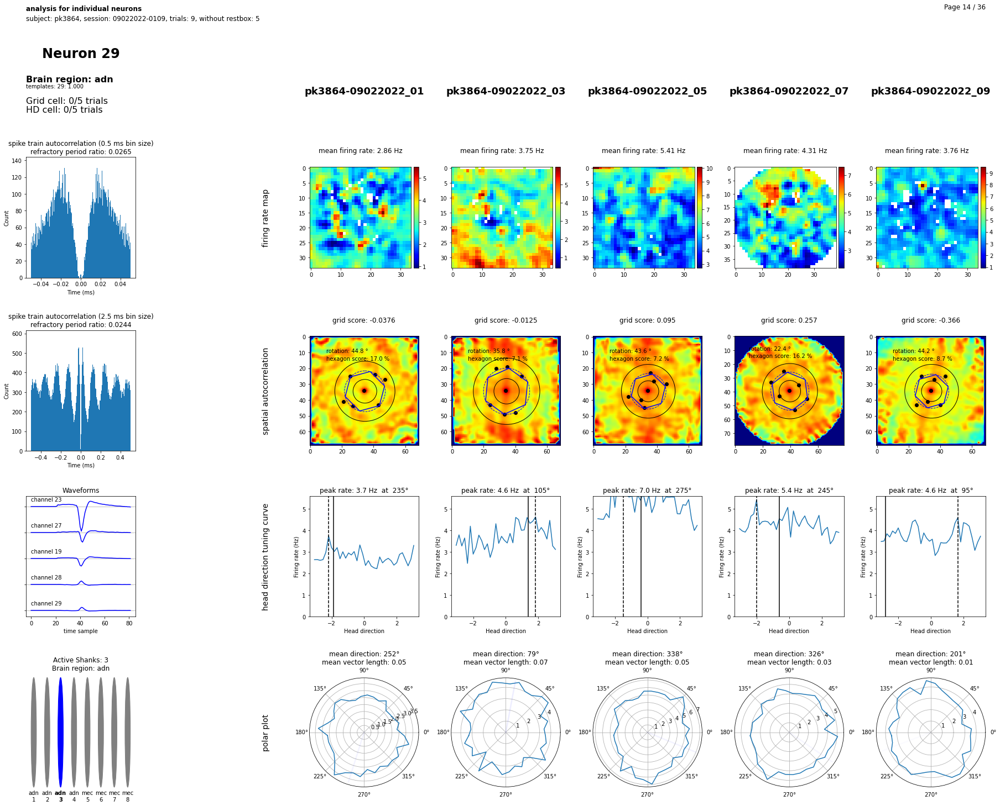

 39%|████████████████▋                          | 14/36 [02:41<04:14, 11.58s/it]

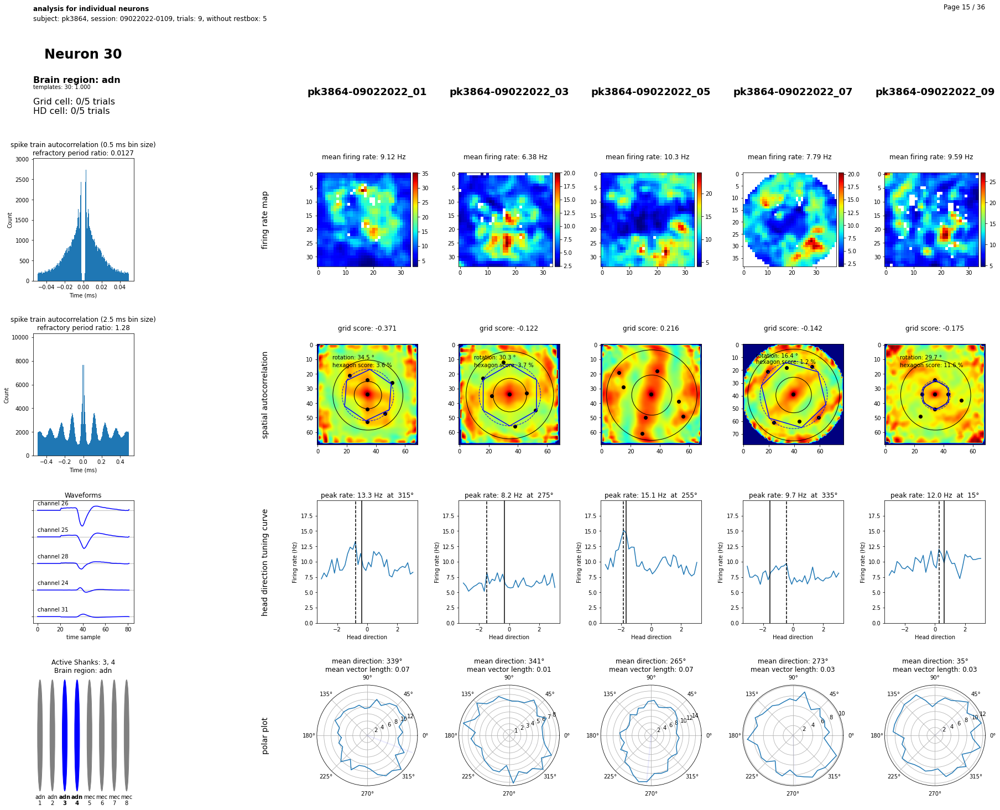

 42%|█████████████████▉                         | 15/36 [02:53<04:05, 11.68s/it]

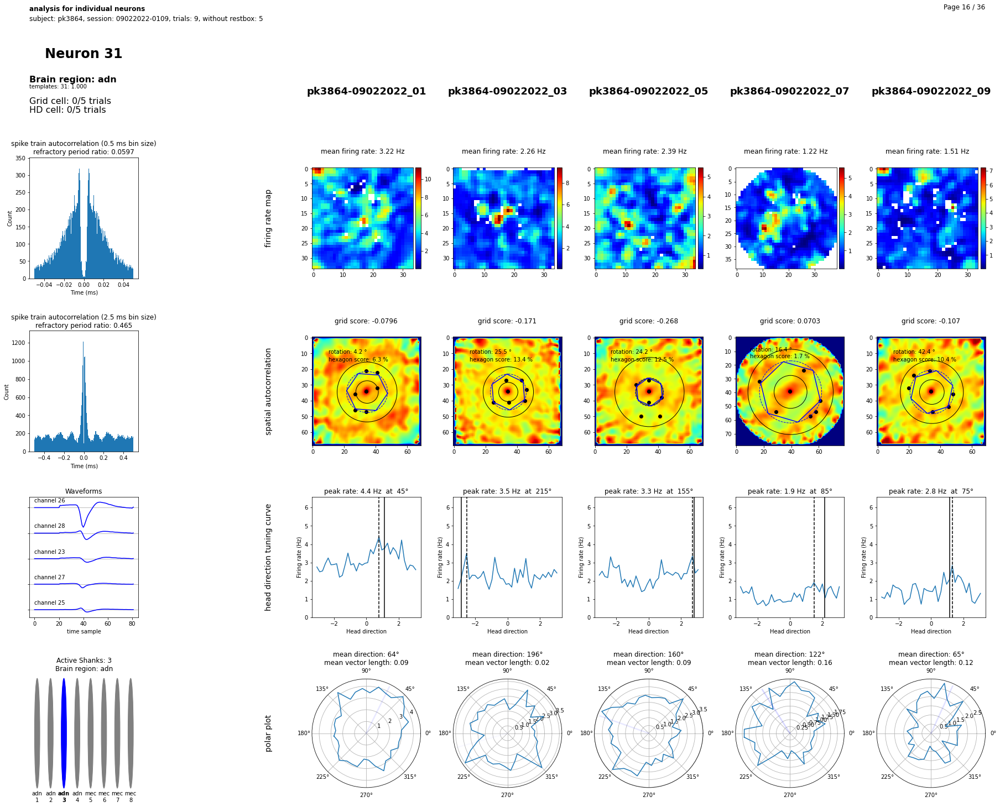

 44%|███████████████████                        | 16/36 [03:04<03:52, 11.65s/it]

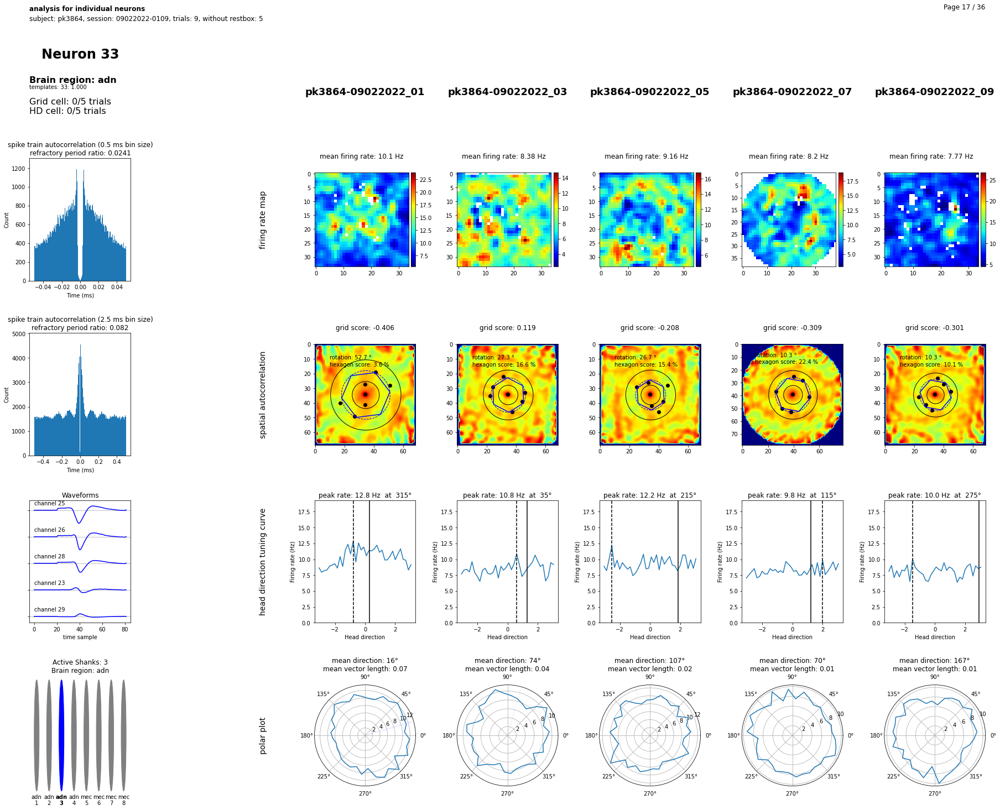

 47%|████████████████████▎                      | 17/36 [03:16<03:42, 11.69s/it]

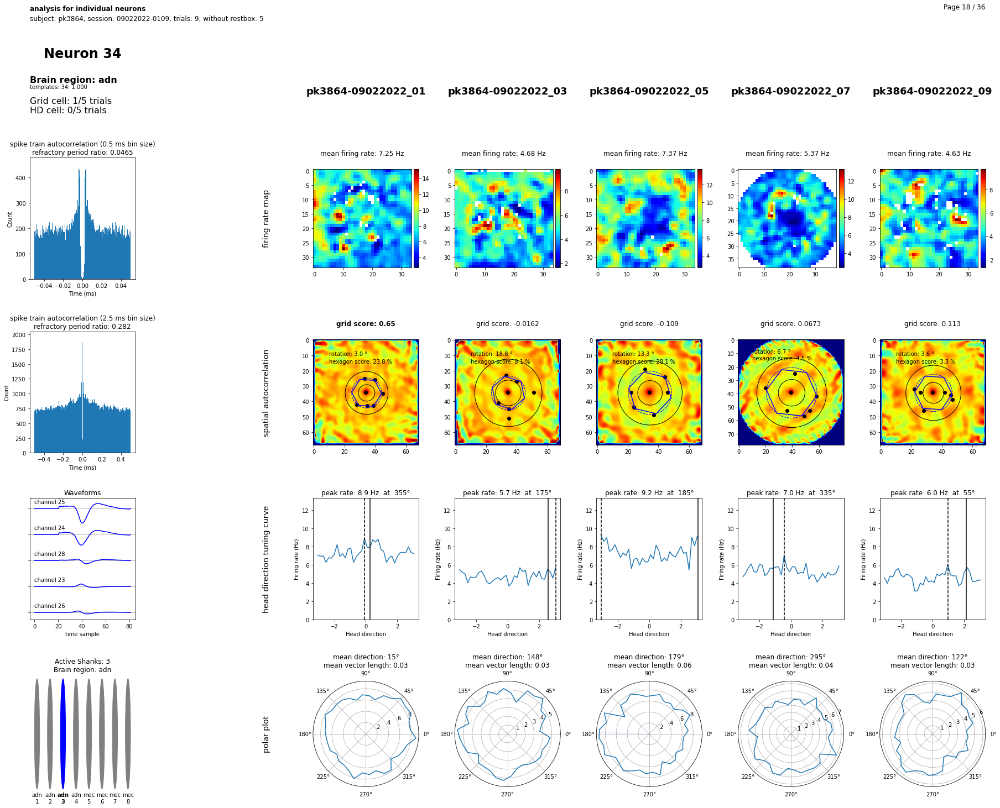

 50%|█████████████████████▌                     | 18/36 [03:27<03:27, 11.54s/it]

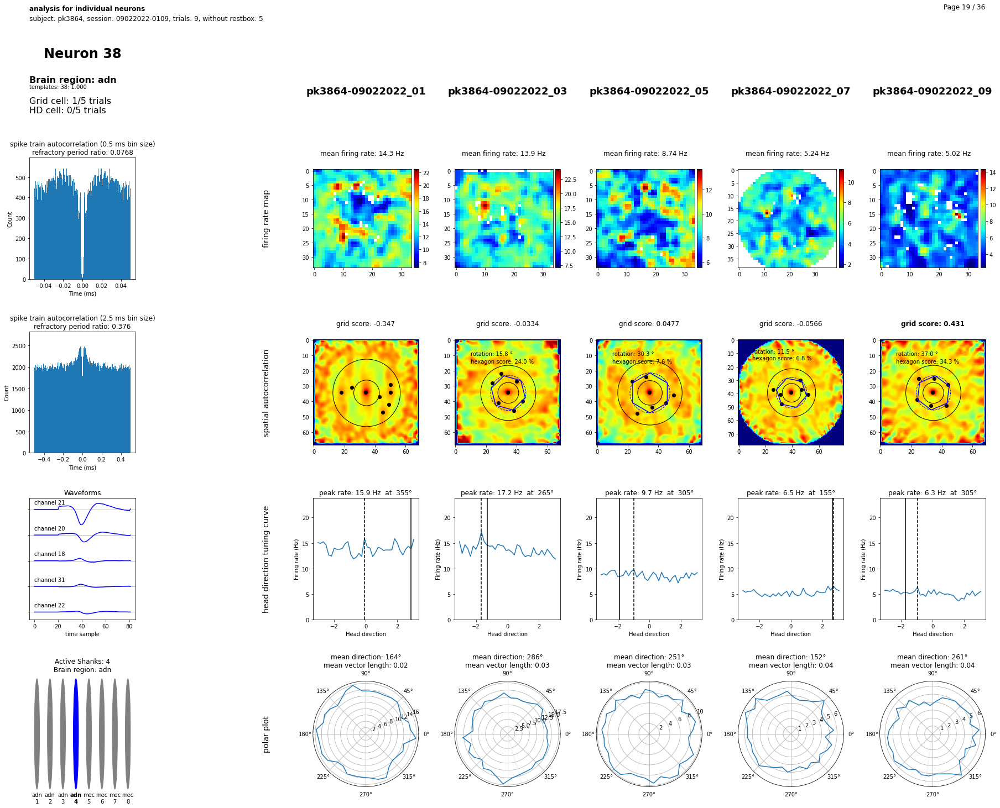

 53%|██████████████████████▋                    | 19/36 [03:39<03:16, 11.54s/it]

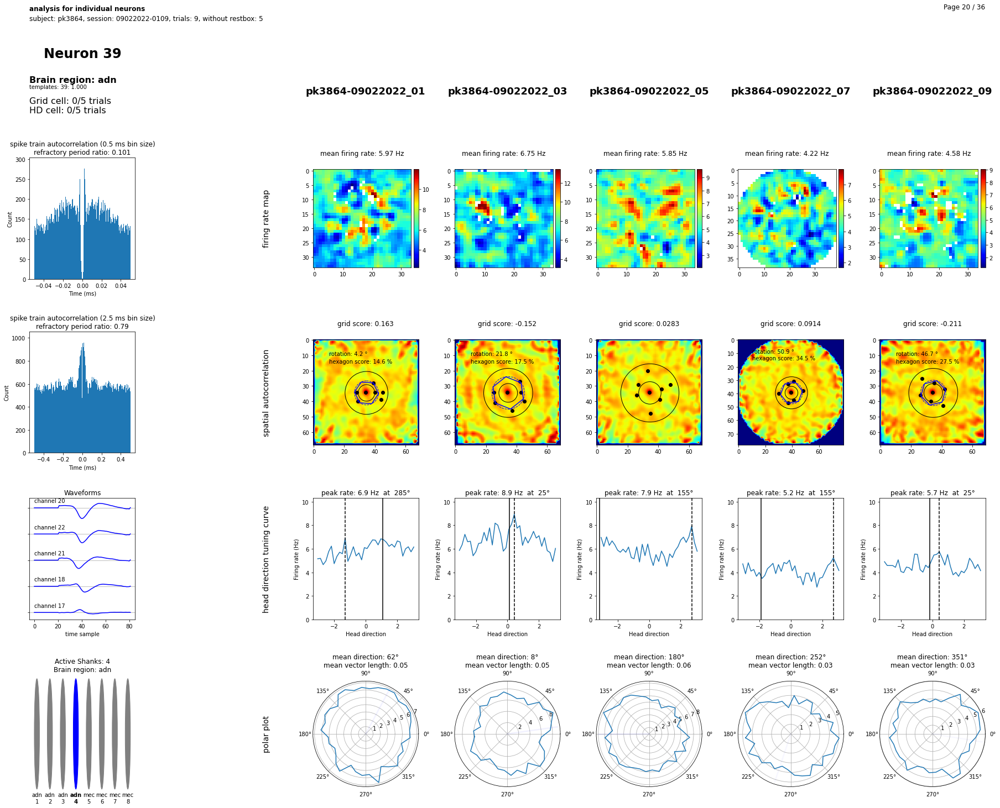

 56%|███████████████████████▉                   | 20/36 [03:51<03:07, 11.70s/it]

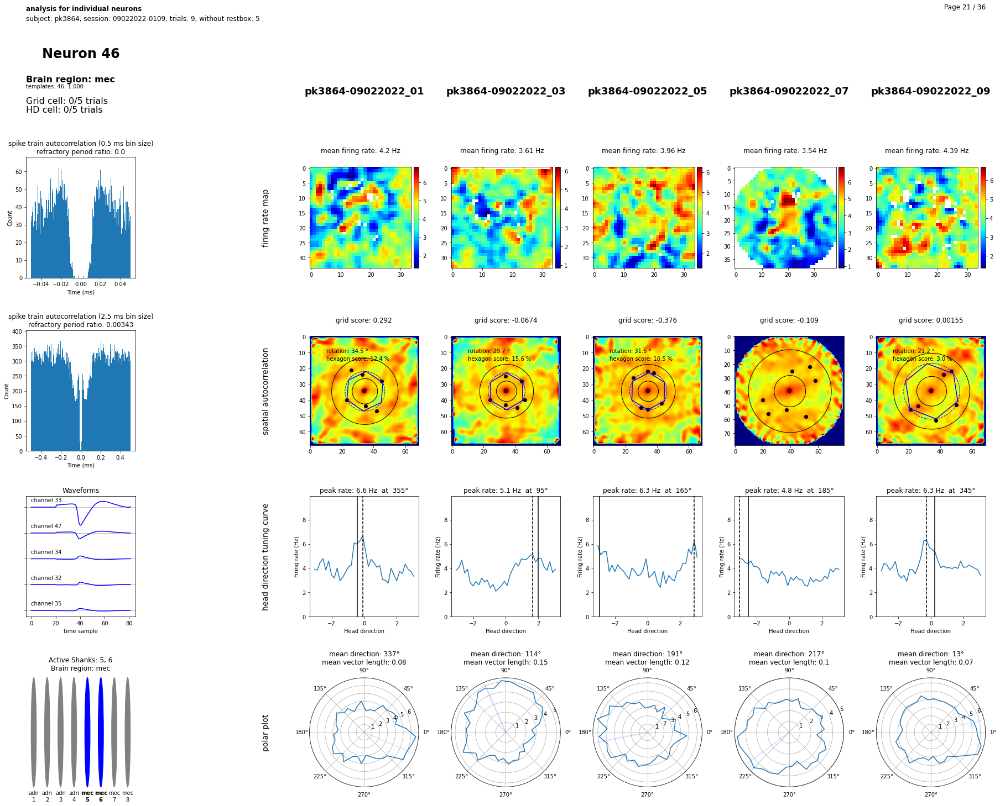

 58%|█████████████████████████                  | 21/36 [04:02<02:53, 11.55s/it]

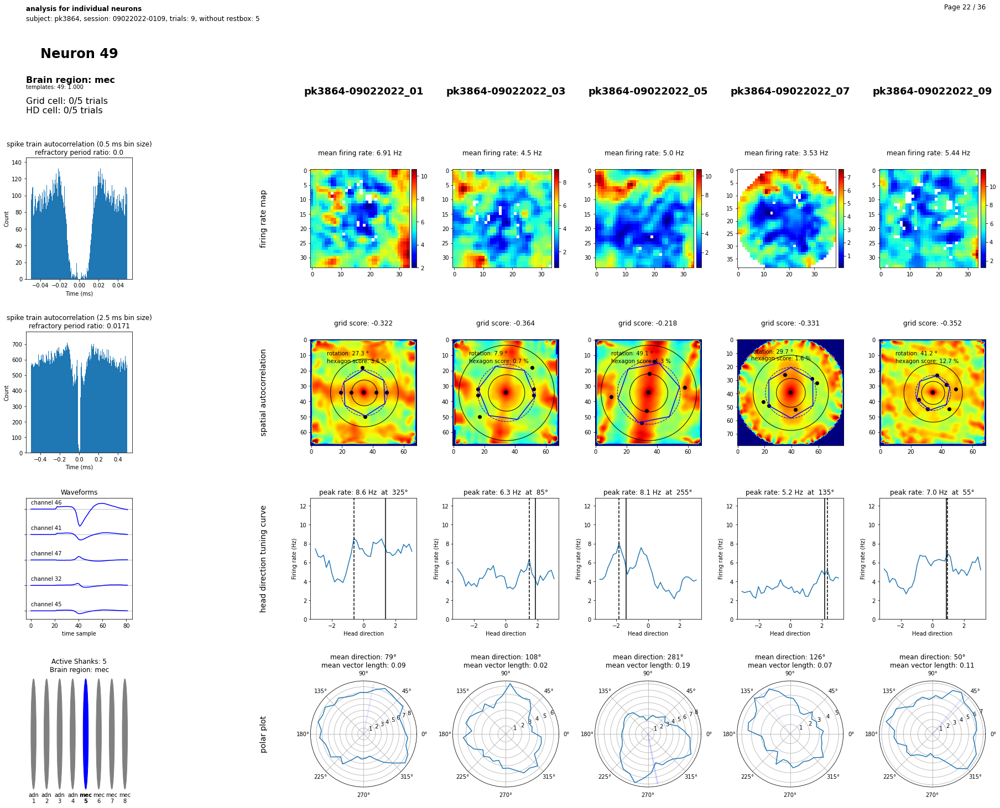

 61%|██████████████████████████▎                | 22/36 [04:14<02:41, 11.55s/it]

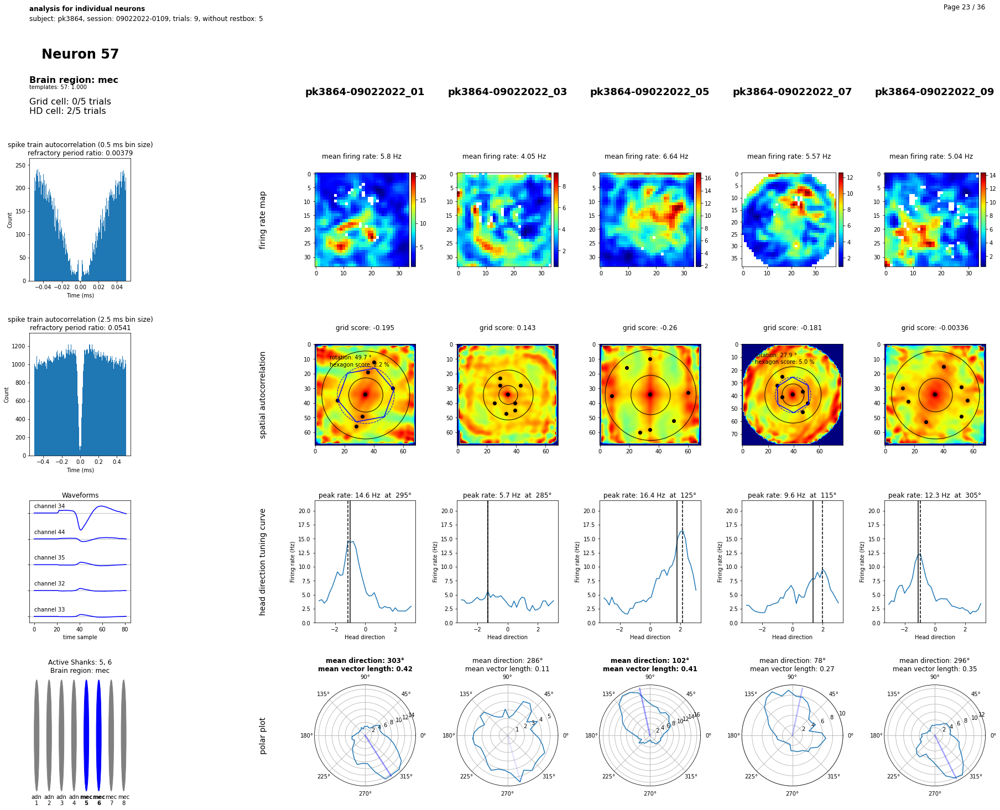

 64%|███████████████████████████▍               | 23/36 [04:26<02:32, 11.70s/it]

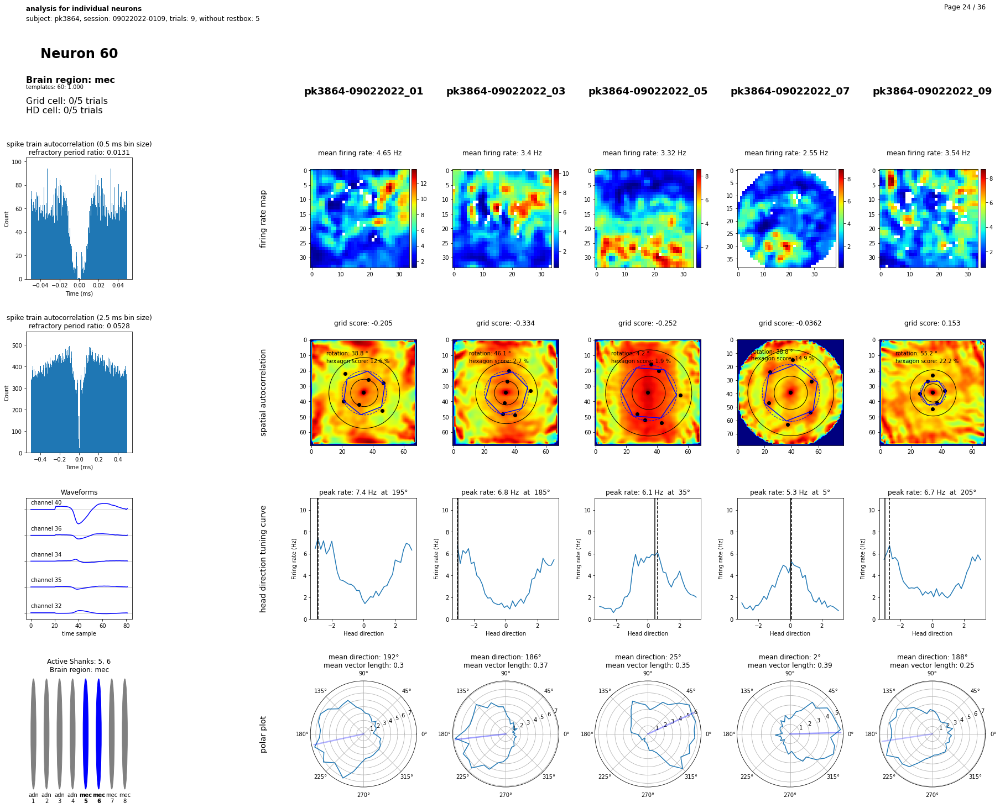

 67%|████████████████████████████▋              | 24/36 [04:37<02:19, 11.66s/it]

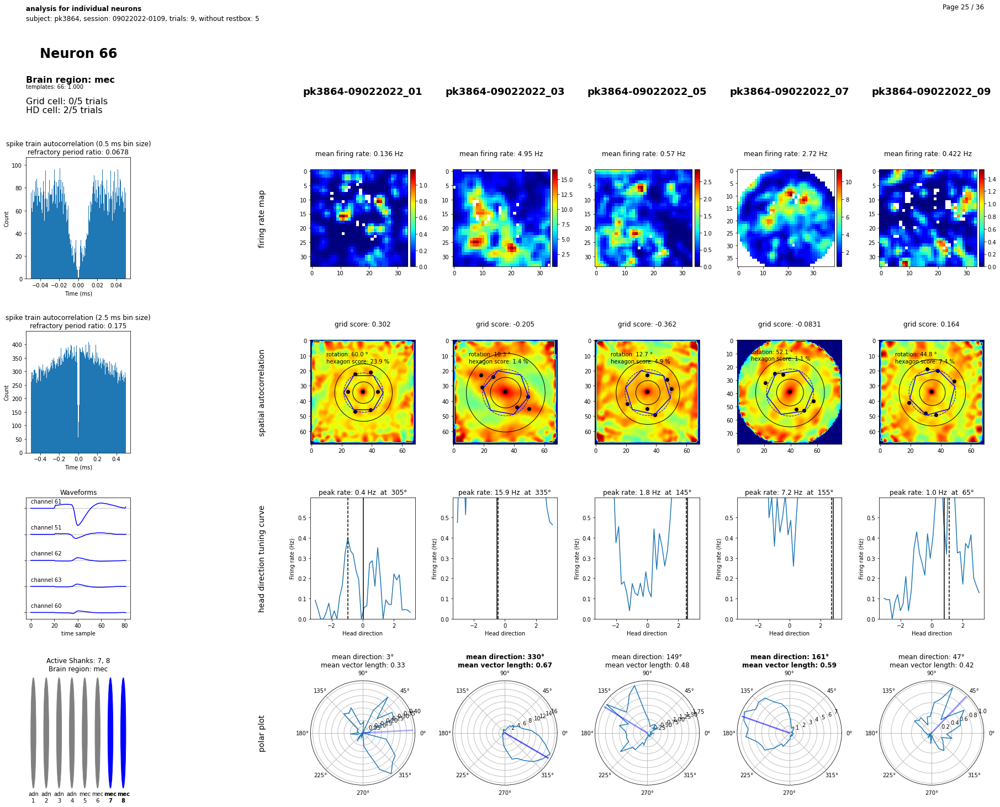

 69%|█████████████████████████████▊             | 25/36 [04:49<02:07, 11.61s/it]

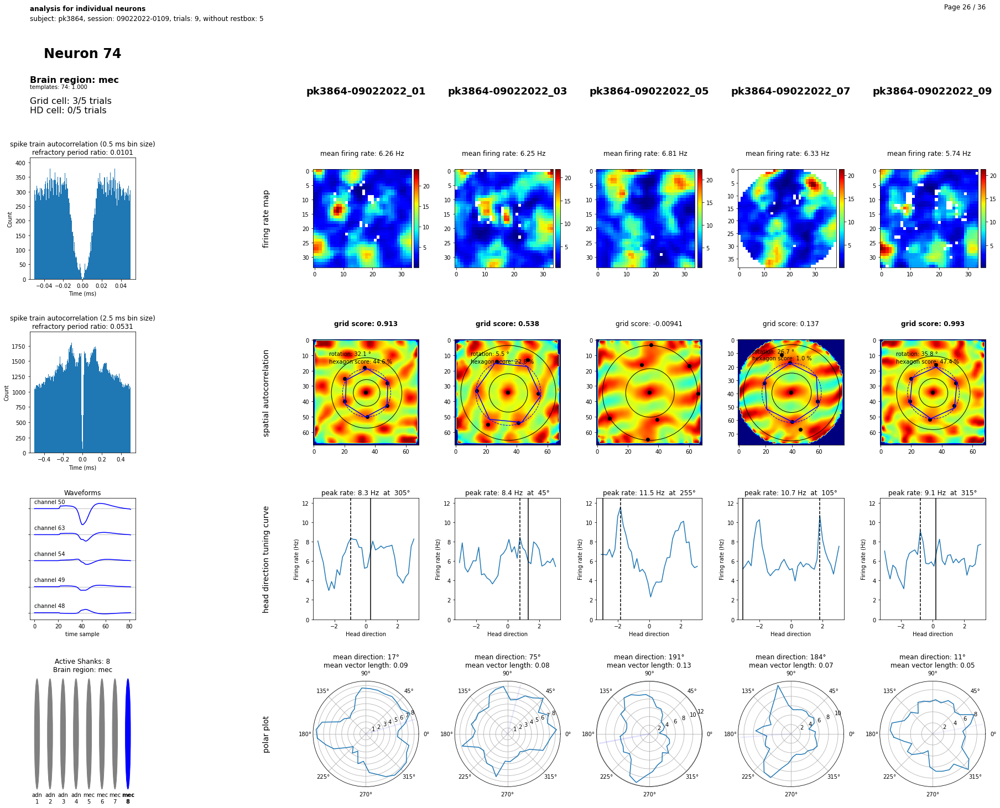

 72%|███████████████████████████████            | 26/36 [05:00<01:54, 11.50s/it]

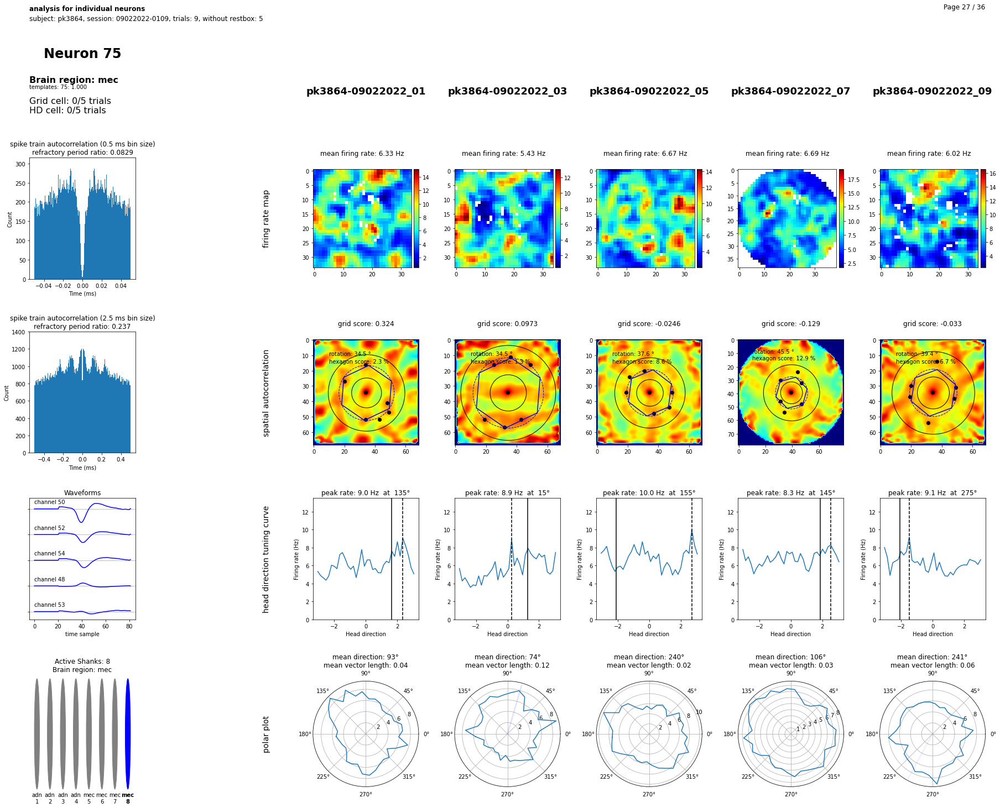

 75%|████████████████████████████████▎          | 27/36 [05:11<01:42, 11.39s/it]

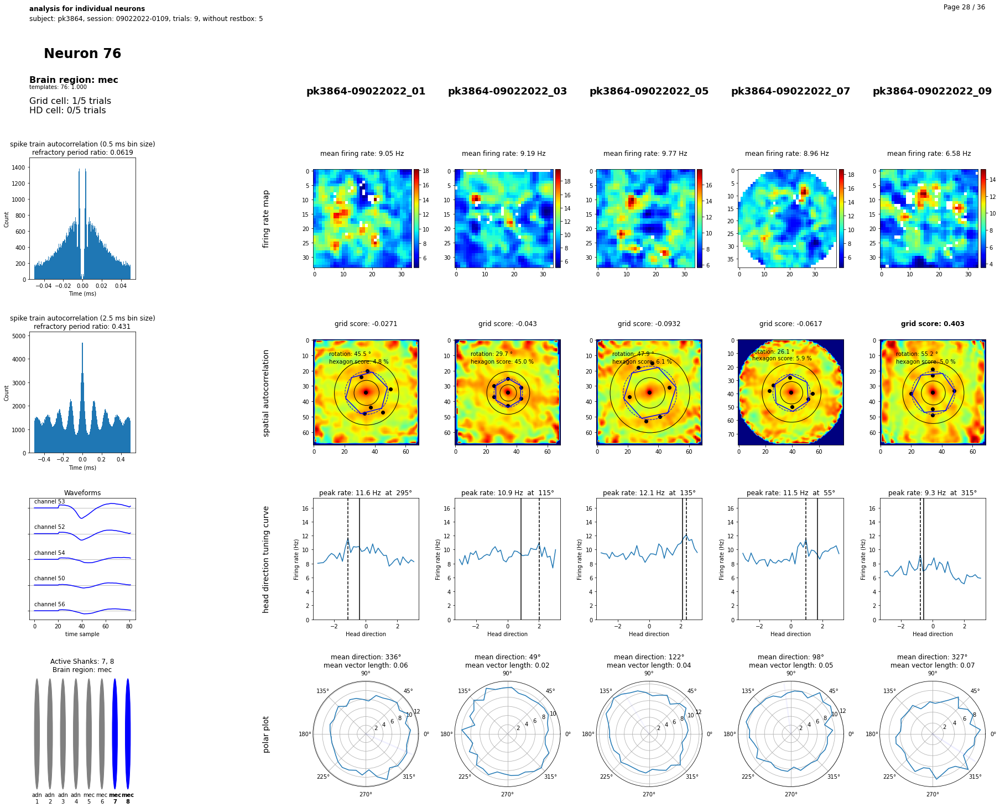

 78%|█████████████████████████████████▍         | 28/36 [05:23<01:31, 11.48s/it]

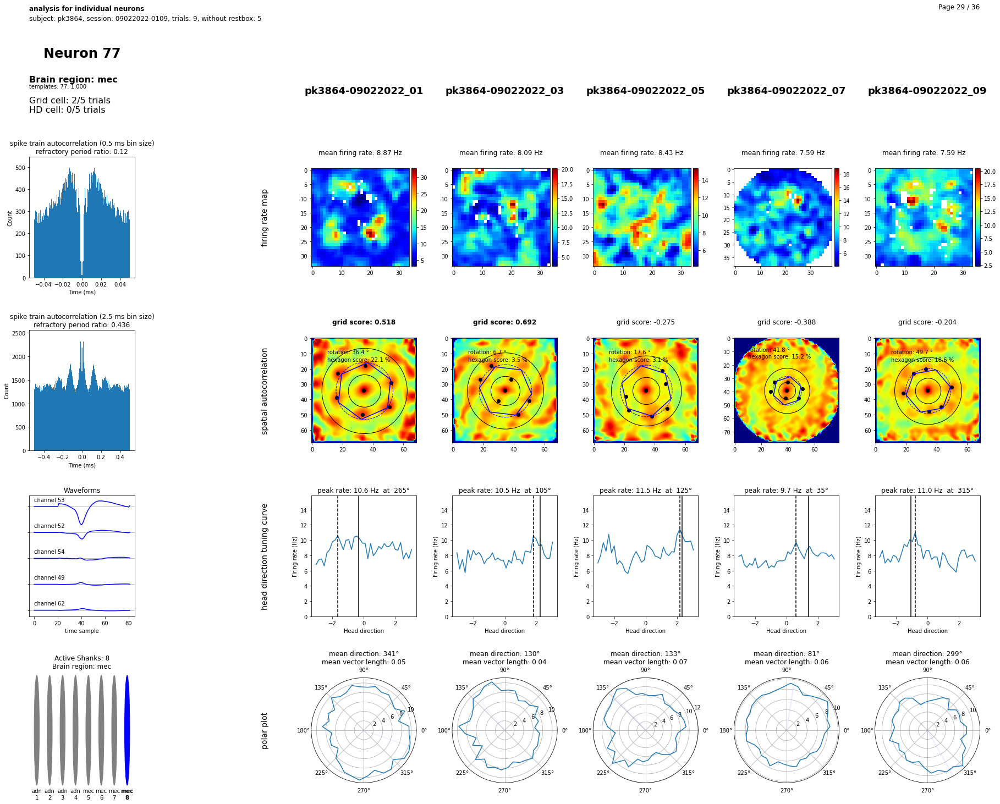

 81%|██████████████████████████████████▋        | 29/36 [05:34<01:20, 11.45s/it]

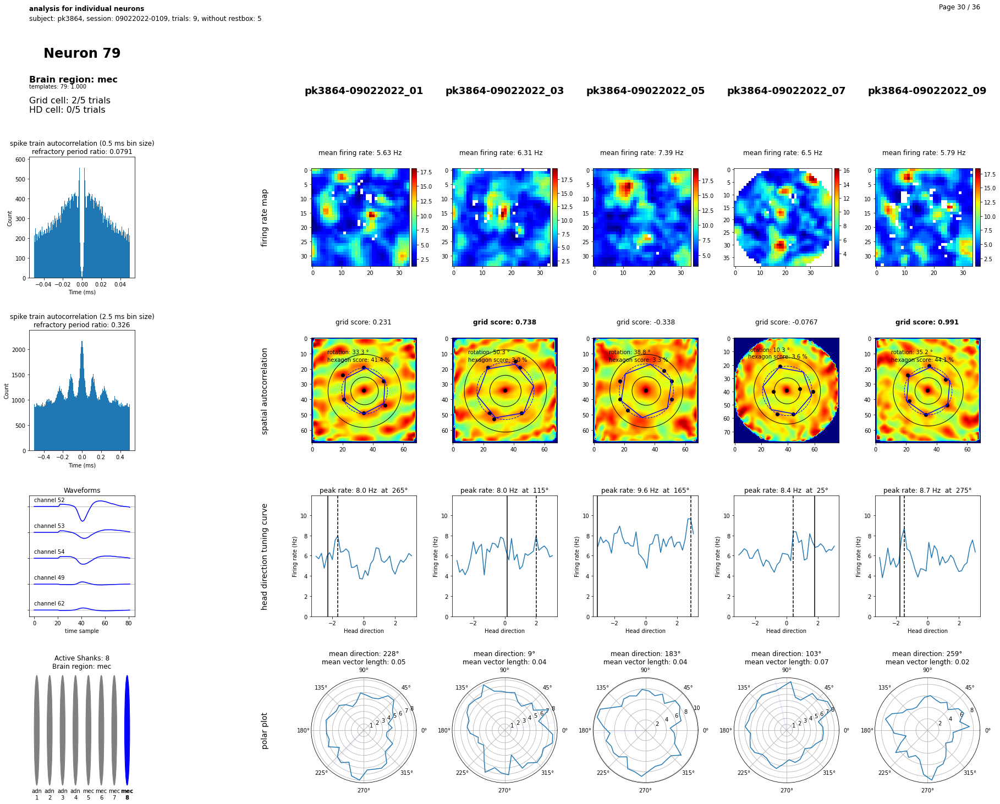

 83%|███████████████████████████████████▊       | 30/36 [05:46<01:08, 11.45s/it]

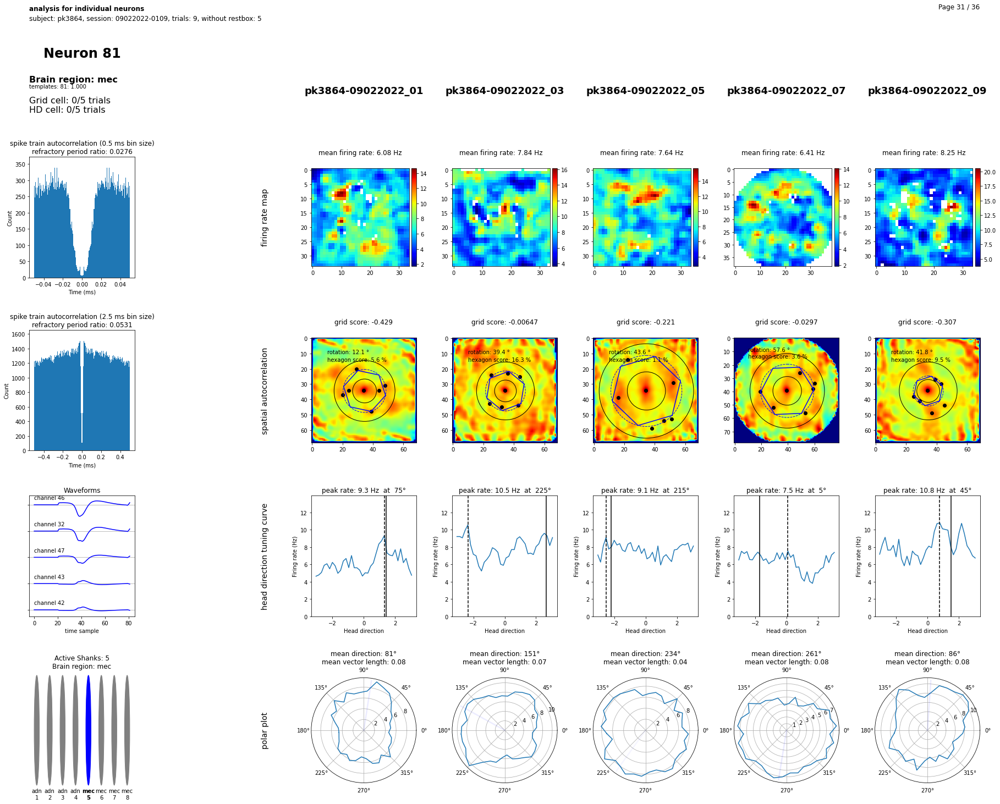

 86%|█████████████████████████████████████      | 31/36 [05:57<00:56, 11.39s/it]

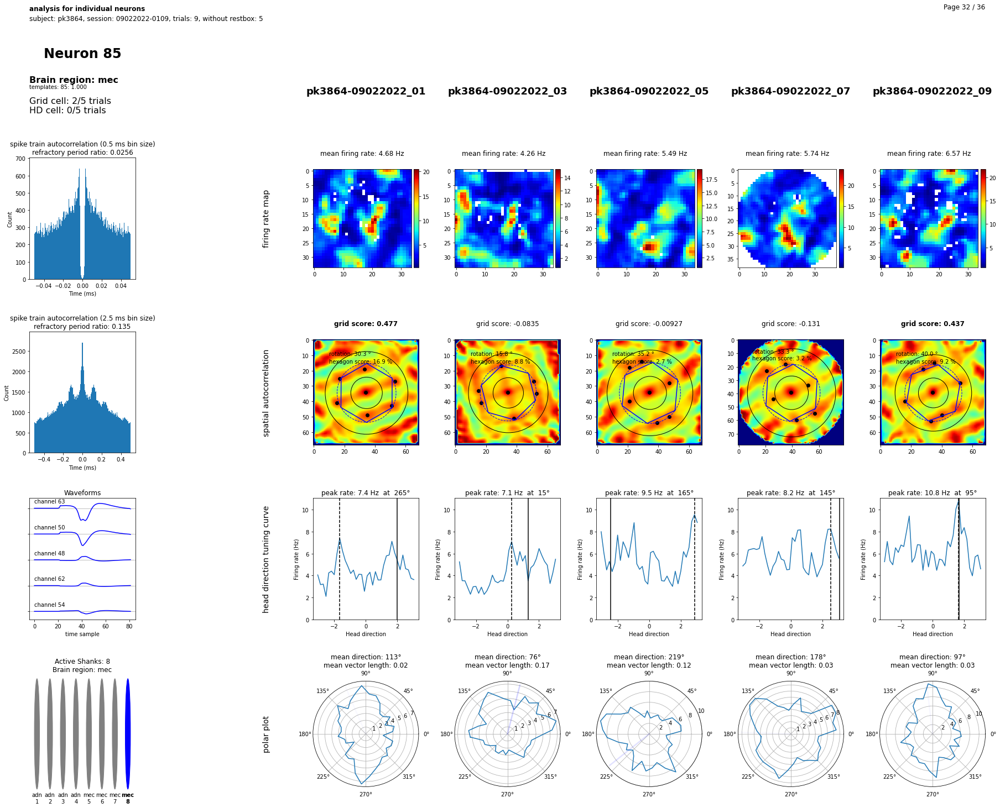

 89%|██████████████████████████████████████▏    | 32/36 [06:08<00:45, 11.35s/it]

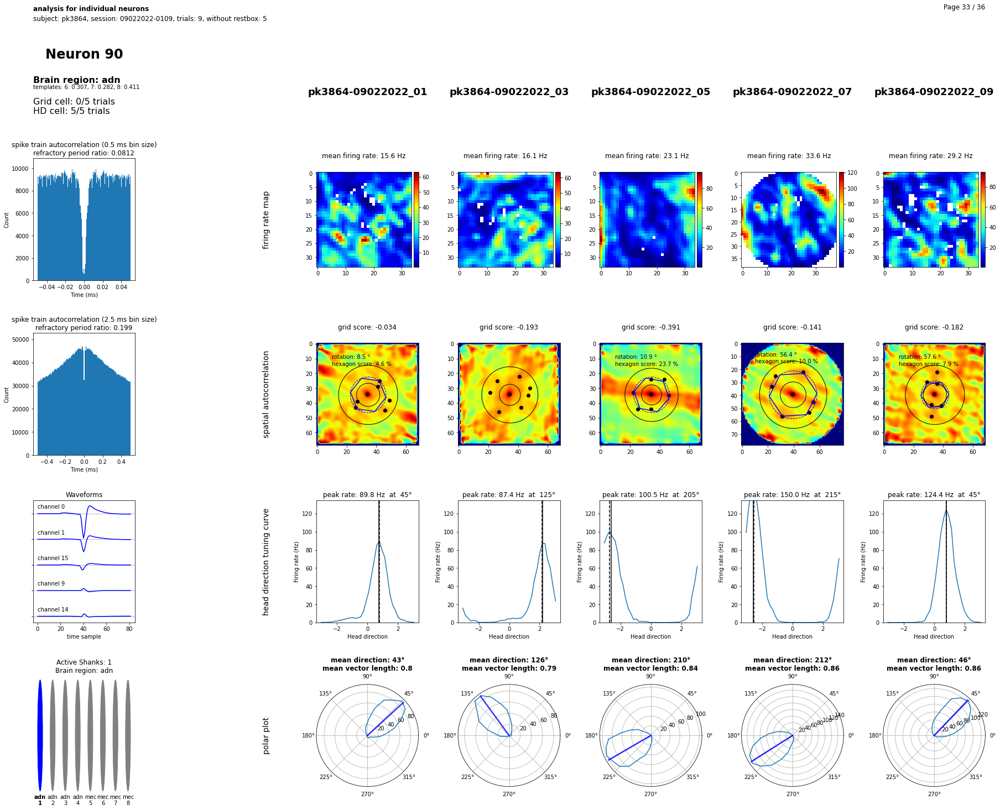

 92%|███████████████████████████████████████▍   | 33/36 [06:19<00:34, 11.38s/it]

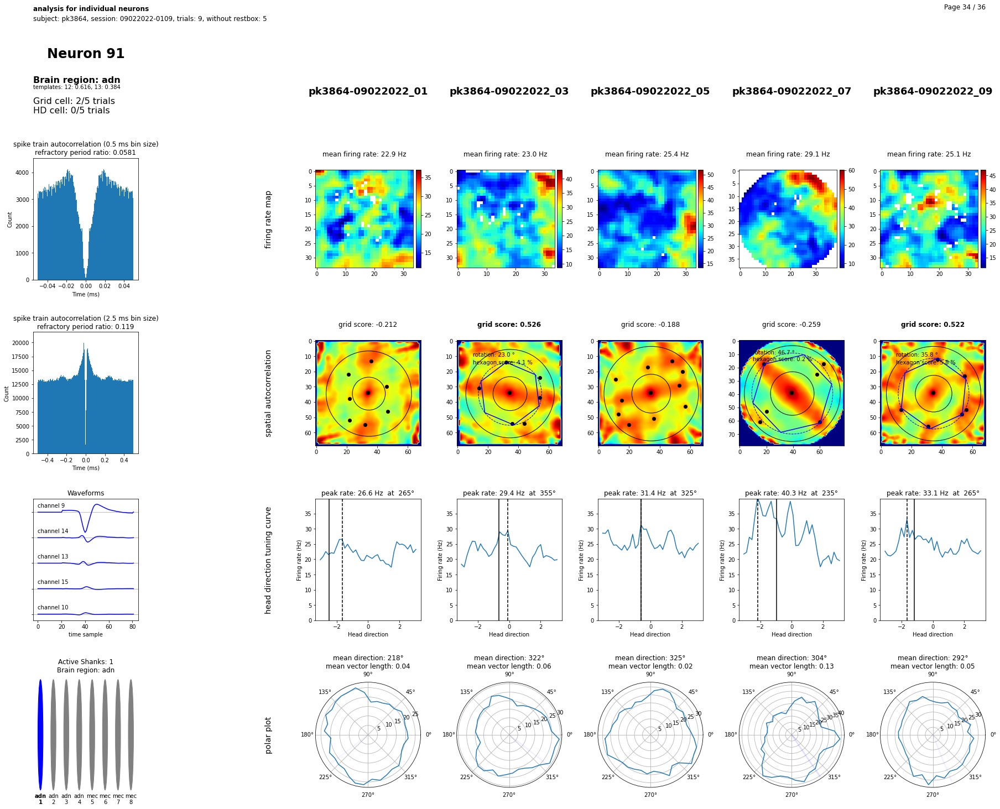

 94%|████████████████████████████████████████▌  | 34/36 [06:31<00:22, 11.46s/it]

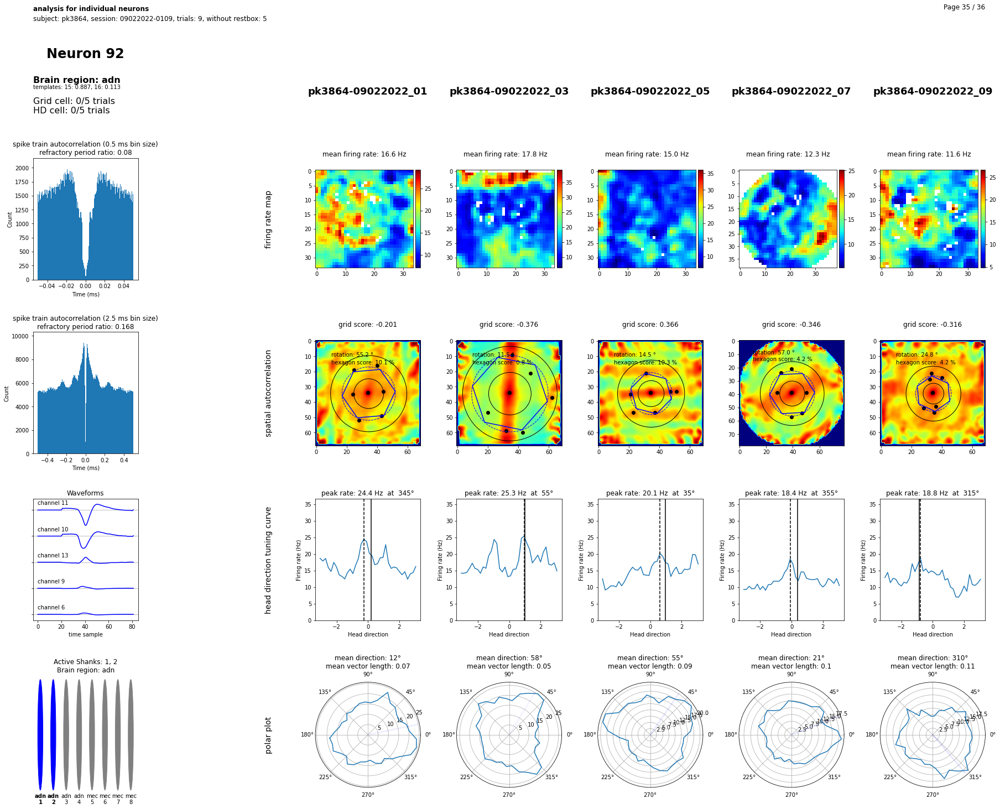

 97%|█████████████████████████████████████████▊ | 35/36 [06:43<00:11, 11.48s/it]

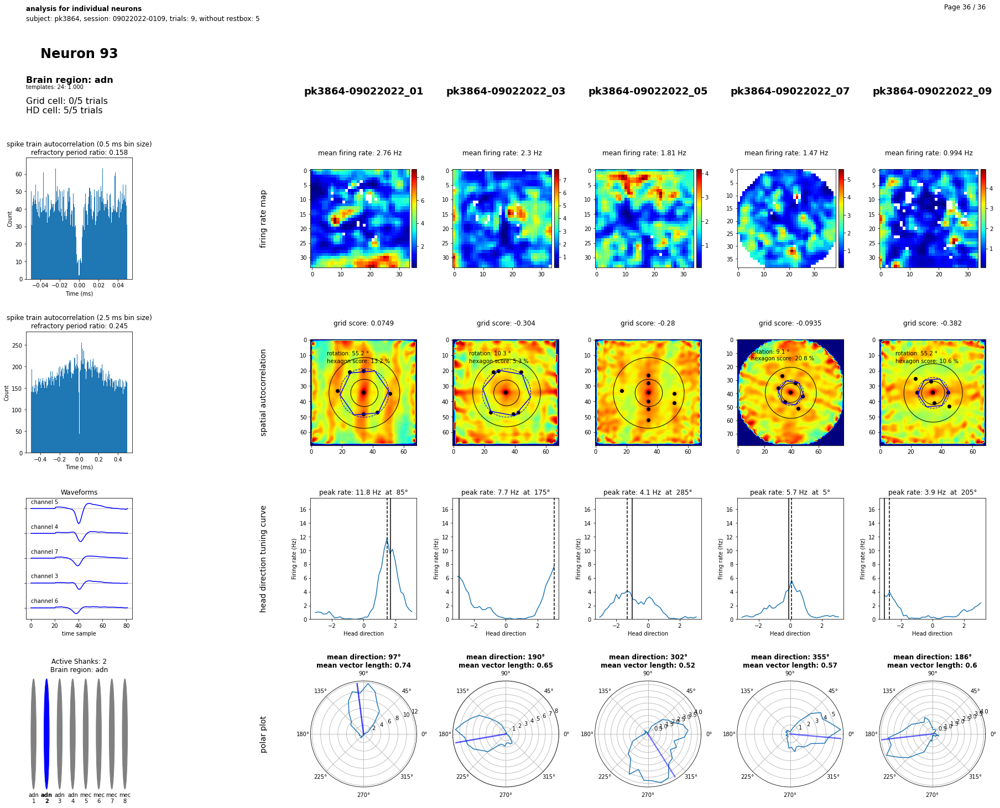

100%|███████████████████████████████████████████| 36/36 [06:54<00:00, 11.51s/it]


In [29]:
pdf = matplotlib.backends.backend_pdf.PdfPages("/home/pascal/Documents/science_docs/analysis_results/"+name+"_cells.pdf")

for N, n in enumerate(tqdm(cg.neuron_list)):
    
    """
    n=cg.neuron_list[44] # testing(break)
    if N>0: # break the next time
        break
    """

    fig = plt.figure(figsize=(25,20), constrained_layout=True)
    layout = fig.add_gridspec(nrows=6, ncols=cols+1, height_ratios= [2,5,10,10,10,10], hspace=.15) # left=0.05, right=0.95, wspace=0.15, hspace=0.15 # width_ratios= [1,0.3]+ trials_in_environment_number*[1]



    # header line with information about subject (stretches entire width)
    ax = fig.add_subplot(layout[0, :])
    ax.set_xlim([0, 10])
    ax.set_ylim([0, 5])
    ax.invert_yaxis()
    ax.axis('off')
    ax.text(0.0,1.5,"analysis for individual neurons", fontweight="bold", fontsize=12)
    ax.text(0.0,3.5,"subject: "+subject+", session: "+session+", trials: "+str(ses.n_trials)+", without restbox: "+str(trials_in_environment_number), fontsize=12, clip_on=True)
    ax.text(1.0,1.0, "Page "+str(N+1)+" / "+str(len(cg.neuron_list)), horizontalalignment='right' , verticalalignment='top' , transform=ax.transAxes ,  fontsize=12 )

    # neuron information at top left
    ax_info = fig.add_subplot(layout[1, 0])
    ax_info.set_title("Neuron " + n.name, fontsize=24, fontweight='bold')
    ax_info.set_xlim([0, 10])
    ax_info.set_ylim([0, 10])
    ax_info.invert_yaxis()
    ax_info.axis('off')

    #ax_info.text(0,3,"brain area: "+', '.join(n.brain_area))
    #ax_info.text(0,4,"active channels ("+str(len(n.channels))+"): "+', '.join([str(c) for c in n.channels]))


    ax = fig.add_subplot(layout[2, 0])
    ax.set_visible(False)

    ax = fig.add_subplot(layout[3, 0])
    ax.set_visible(False)

    #ax = fig.add_subplot(layout[1, 1])
    #ax.set_visible(False)






    # spike time autocorrelation and refractory period ratio for entire session

    n.spike_train.unset_intervals()

    ax = fig.add_subplot(layout[2, 0])
    # n.spike_train.spike_time_autocorrelation(bin_size_sec=0.0005,min_sec=-0.05, max_sec=0.05)
    rpr = n.spike_train.refractory_period_ratio(bin_size_sec=0.0005,min_sec=-0.05, max_sec=0.05)
    ax.bar(n.spike_train.mid_point_from_edges(n.spike_train.st_autocorrelation_histogram[1]), n.spike_train.st_autocorrelation_histogram[0], width=0.0005)
    ax.set_ylim((0,np.max(n.spike_train.st_autocorrelation_histogram[0])*1.1))
    ax.set_xlabel("Time (ms)")
    ax.set_ylabel("Count")
    ax.set_title("spike train autocorrelation (0.5 ms bin size)"+"\n"+"refractory period ratio: {:.3}".format(rpr))

    ax = fig.add_subplot(layout[3, 0])
    # n.spike_train.spike_time_autocorrelation(bin_size_sec=0.0025,min_sec=-0.5, max_sec=0.5)
    rpr = n.spike_train.refractory_period_ratio(bin_size_sec=0.0025,min_sec=-0.5, max_sec=0.5)
    ax.bar(n.spike_train.mid_point_from_edges(n.spike_train.st_autocorrelation_histogram[1]), n.spike_train.st_autocorrelation_histogram[0], width=0.0025)
    ax.set_ylim((0,np.max(n.spike_train.st_autocorrelation_histogram[0])*1.1))
    ax.set_xlabel("Time (ms)")
    ax.set_ylabel("Count")
    ax.set_title("spike train autocorrelation (2.5 ms bin size)"+"\n"+"refractory period ratio: {:.3}".format(rpr))

    ##
    # Waveforms
    ax = fig.add_subplot(layout[4, 0])
    cluster = int(n.name) # current cluster name
    channels = ses.get_channels_from_cluster(cluster) # get channels with highest amplitude
    if (len(channels)):
        for j,channel in enumerate(channels):
            channel_mapped, waveform = ses.get_waveform_from_cluster(cluster, channel)
            ax.axhline( y = -j*.5 , color="grey" , lw=.5 )
            #label = "channel: "+str(channel)+" ("+str(channel_mapped)+")"
            label = "channel "+str(channel_mapped)
            ax.plot( waveform -j*.5 , label=label , color="blue")
            ax.text( s= label , x=0, y=-j*.5 +.1 )
        ax.set_xlabel("time sample")
        ax.set(yticklabels=[])  
        ax.set_title("Waveforms")

    unique, weights = ses.decompose_cluster(cluster)
    cluster_decomposed = dict(zip(unique, weights)) # decomposed into templates
    cluster_decomposed_str = ', '.join(["{}: {:.3f}".format(t,w) for t,w in zip(unique,weights)])

    
    # shanks
    
    ax = fig.add_subplot(layout[5, 0])
    ax.set_xlim([-1, len(ses.shanks_all)])
    ax.set_ylim([-1, 1])
    shanks_arr, active_shanks, electrodes = ses.get_active_shanks(channels)
    for j, (shank, active, el) in enumerate(zip(ses.shanks_all, shanks_arr, ses.desel)):
        color,fontweight = ('blue','bold') if active else ('gray',None)
        circle = plt.Circle((j,0), 0.2, color=color)
        ax.add_patch(circle)
        ax.text(x=j, y=-.25, s=el+"\n"+str(int(shank)), fontweight=fontweight, ha='center')
    ax.axis('off')
    ax.autoscale(enable=True)
    brain_region_txt = "Brain region: "+ ' / '.join(electrodes)
    ax.set_title("Active Shanks: " + ', '.join([str(int(active_shank)) for active_shank in active_shanks]) + "\n" + brain_region_txt , pad=0)

    # ax_info.text(0,4,brain_region_txt + "\n ("+ ("unique" if len(electrodes)==1 else "ambiguous") +")" , fontweight='bold' , fontsize=16 ) # add this information to info text
    ax_info.text(0,3.5, brain_region_txt , fontweight='bold' , fontsize=16  )
    ax_info.text(0,4.5, "templates: "+cluster_decomposed_str )


    # y label for trial plots

    ylabels = ["firing rate map", "spatial autocorrelation", "head direction tuning curve", "polar plot"]

    for c,ylabel in enumerate(ylabels):
        ax = fig.add_subplot(layout[2+c, 1])
        ax.set_xlim([0, 10])
        ax.set_ylim([0, 10])
        ax.invert_yaxis()
        ax.axis('off')
        ax.text(9, 5, ylabel, fontsize=14, ha='center', va='center', rotation=90)


    # collect information and classify (per trial)

    hd_cells = []   # list: is HD cell (bool)
    grid_cells = [] # list: is grid cell (bool)

    hd_angles = [] # list: mean direction angle
    
    firing_rate_maps = [] # list: firing rate maps
    grid_rotations = [] # list: autocorrelation hexagon rotation (derived from firing rate map -> autocorrelation map -> hexagon)



    ### per trial analysis

    i=2 # column to plot appropriate trial
    for t,(tn,su,en,(shape,diam,color,cue),ef,iv) in enumerate(session_trials):
        # skip restbox
        if not t in trials_in_environment:
            continue

        # set interval to specific trial
        n.spatial_properties.set_intervals(iv)

        # detect xy_range (better: do this once per trial, not for every neuron again)
        xy_range = ap.find_xy_range(diameter = diam)
        center = np.mean(xy_range,axis=0)
        n.spatial_properties.ap.invalid_outside_spatial_area(shape=shape, radius=diam/2., length=diam, center=center)

        # write trial name (and information about trial)
        ax = fig.add_subplot(layout[1, i])
        #ax.set_title(tn, fontsize=18, fontweight='bold')
        ax.set_xlim([0, 10])
        ax.set_ylim([0, 10])
        ax.text(5,5,tn, fontsize=18, fontweight='bold', horizontalalignment="center", verticalalignment="center")
        ax.invert_yaxis()
        ax.axis('off')

        # plot firing rate map
        n.spatial_properties.firing_rate_map_2d(cm_per_bin=2, smoothing_sigma_cm =2, smoothing=True, xy_range=xy_range)
        ax = fig.add_subplot(layout[2, i])
        im = ax.imshow(n.spatial_properties.firing_rate_map.T, cmap='jet')
        # n.spatial_properties.firing_rate_map_2d(cm_per_bin=2, smoothing=False, xy_range=xy_range) # recalculate without smoothing for calculate scores, then for displaying do smoothing
        # ax.set_title("mean firing rate: {:.3} Hz".format(n.spike_train.mean_firing_rate())  +"\n"+"sparsity score: "+str(n.spatial_properties.sparsity_score()) + "\n"+"info score: " + str(n.spatial_properties.information_score())  , pad=25)
        ax.set_title("mean firing rate: {:.3} Hz".format(n.spike_train.mean_firing_rate()) , pad=25)
        
        #c = fig.colorbar(im,ax=ax)
        #cax = fig.add_axes([ax.get_position().x1+0.0,ax.get_position().y0,0.01,ax.get_position().height])
        #c = plt.colorbar(im,cax=cax)
        
        add_colorbar(im)
        
        firing_rate_maps.append(n.spatial_properties.firing_rate_map)

        
        # plot autocorrelation maps
        n.spatial_properties.spatial_autocorrelation_map_2d()
        grid_score = n.spatial_properties.grid_score()

        is_grid_cell = (grid_score>0.4)
        grid_cells.append(is_grid_cell)

        fw='bold' if is_grid_cell else 'normal'

        ax = fig.add_subplot(layout[3, i])
        ax.imshow(n.spatial_properties.spatial_autocorrelation_map, cmap='jet')
        ax.set_title("grid score: {:.3}".format(grid_score), fontweight=fw, pad=25)
        
        rotation = np.nan

        points_inside_dougnut = n.spatial_properties.points_inside_dougnut
        
        if len(points_inside_dougnut):
        
            for x,y in points_inside_dougnut:
                ax.scatter(x,y, color='black')

            midpoint = n.spatial_properties.autocorr_midpoint
            circle_outer = plt.Circle(midpoint, n.spatial_properties.r_outer_radius_use, color='black' , fill=False)
            circle_inner = plt.Circle(midpoint, n.spatial_properties.r_inner_radius_use, color='black' , fill=False)

            ax.add_patch(circle_outer)
            ax.add_patch(circle_inner)


            grid_info = n.spatial_properties.grid_info()
            if grid_info is not False:

                hexagon_radius, rotation, error, hexagon_rotated = grid_info

                circle_median = plt.Circle(midpoint, hexagon_radius, color='blue', ls='dashed', fill=False)
                ax.add_patch(circle_median)

                ax.plot(hexagon_rotated[:,0], hexagon_rotated[:,1] , color="blue")

                ax.text(10,10, "rotation: {:3.1f} °".format(rotation*360/(2*np.pi)))
                ax.text(10,15, "hexagon score: {:2.1f} %".format(np.exp(-error/10)*100))
                
        grid_rotations.append(rotation)



        # plot HD

        n.spatial_properties.firing_rate_head_direction_histogram(smoothing=False)
        angles = n.spatial_properties.mid_point_from_edges(n.spatial_properties.firing_rate_head_direction_histo_edges)
        hd_firing = n.spatial_properties.firing_rate_head_direction_histo
        hd_mean_direction_rad, hd_mean_direction_deg, hd_mean_vector_length, hd_peak_angle_rad, hd_peak_rate = n.spatial_properties.head_direction_score()

        is_hd_cell = (hd_mean_vector_length>.4 and hd_peak_rate>3) # check for vector len AND peak rate
        hd_cells.append(is_hd_cell)

        hd_angles.append(hd_mean_direction_deg)

        fw='bold' if is_hd_cell else 'normal'

        # cartesian HD
        ax = fig.add_subplot(layout[4, i])
        ax.plot(angles, hd_firing)
        ax.set_xlabel("Head direction")
        ax.set_ylabel("Firing rate (Hz)")
        if t==0:
            ymax = np.max(n.spatial_properties.firing_rate_head_direction_histo)*1.5 # first col defines y scaling
        ax.set_ylim(0,ymax)
        ax.axvline(x=hd_mean_direction_rad, color="black")
        ax.axvline(x=hd_peak_angle_rad, color="black", ls="dashed")
        ax.set_title("peak rate: {:.1f} Hz  at  {:.0f}°".format(hd_peak_rate, hd_peak_angle_rad*180/np.pi % 360))

        # polar HD
        ax = fig.add_subplot(layout[5, i], polar=True)
        ax.plot(np.append(angles,angles[0]), np.append(hd_firing,hd_firing[0]))
        if np.isfinite(hd_mean_vector_length):
            ax.plot([hd_mean_direction_rad]*2, [0,max(hd_firing)] , color="blue", alpha=hd_mean_vector_length, lw=2.5  ) # plot hd_peak_rate at hd_mean_direction
        if (np.isfinite(hd_mean_direction_deg) and np.isfinite(hd_mean_vector_length)):
            ax.set_title("mean direction: " + str(round( (hd_mean_direction_deg + 360) % 360  )) +"°" + "\n" + "mean vector length: " + str(np.round(hd_mean_vector_length,2))  , fontweight=fw) 
        else:
            ax.set_title("no valid data")
        ax.grid(True)





        i+=1

    # add this information to info text
    ax_info.text(0,7, "Grid cell: {}/{} trials".format(sum(grid_cells),len(grid_cells)) , fontsize=16)
    ax_info.text(0,8.5, "HD cell: {}/{} trials".format(sum(hd_cells),len(hd_cells)) , fontsize=16)
    
    # add to global list
    hd_cells_all.append(hd_cells)
    grid_cells_all.append(grid_cells)
    hd_angles_all.append(hd_angles)
    firing_rate_maps_all.append(firing_rate_maps)
    grid_rotations_all.append(grid_rotations)
    
    
    # ----------------------
    
    pdf.savefig( fig )
    
    plt.show()
    plt.close()
    
    # break # for testing

pdf.close()

## Analysis for spatial selective neurons

### **HD analysis**

In [30]:
hd_cells_ = np.all(hd_cells_all,axis=1)
print("HD cells:", sum(hd_cells_), "out of", len(hd_cells_), "cells")

HD cells: 8 out of 36 cells


In [31]:
np.array(hd_angles_all).shape

(36, 5)

In [32]:
def angle_diff(a,b, maxangle=360):
    delta = abs(a-b)
    return min( delta, maxangle-delta )

In [33]:
def angle_diff_matrix(angle_list, maxangle=360):
    return np.array([ [ angle_diff(angle_list[i], angle_list[j]) for i in range(len(angle_list)) ] for j in range(len(angle_list)) ])

#### calculate the **HD re-anchoring**

In [34]:
trial_labels = [ str(t+1)+" : "+su+" / "+en for t,(tn,su,en,(shape,diam,color,cue),ef,iv) in enumerate(session_trials) if t in trials_in_environment ]

In [35]:
trial_labels

['1 : 28B / sqr-70_black_cue-W',
 '3 : 28B / sqr-70_white_cue-N',
 '5 : 55B / sqr-70_black_cue-E',
 '7 : 55B / circ-80_black_cue-S',
 '9 : 28B / sqr-70_black_cue-W']

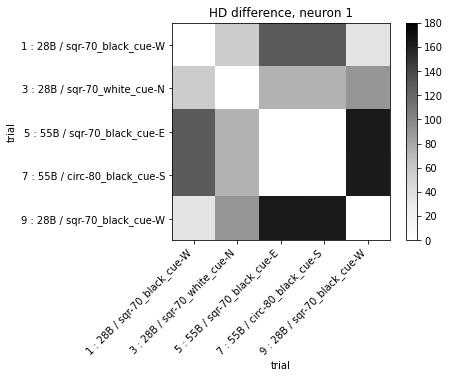

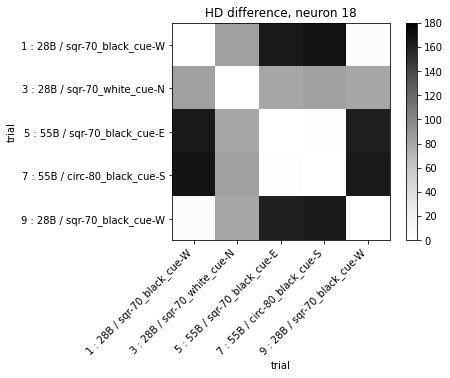

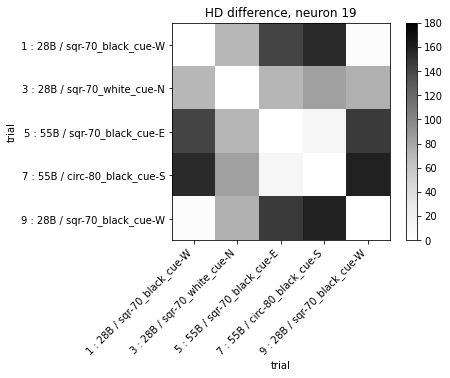

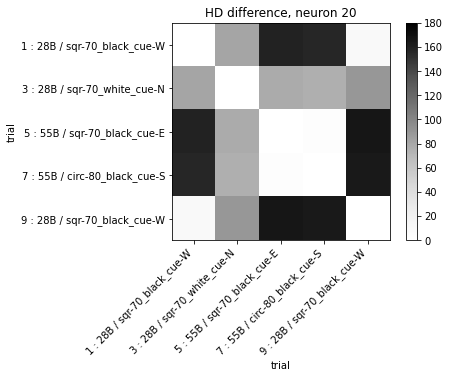

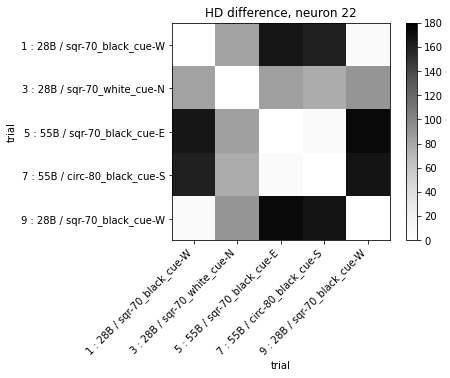

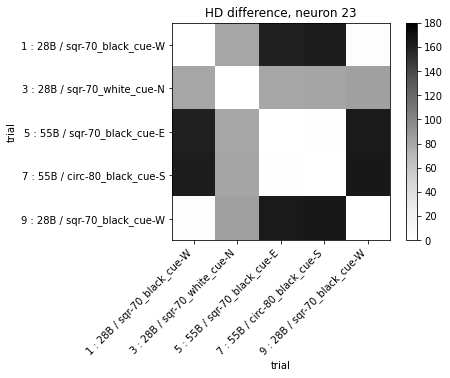

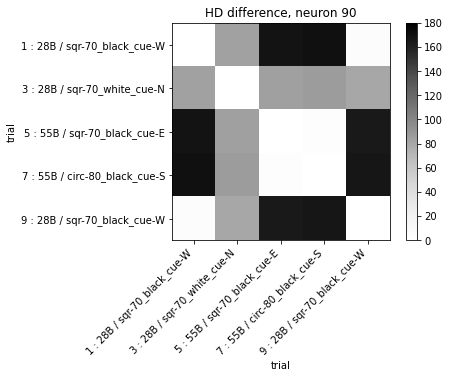

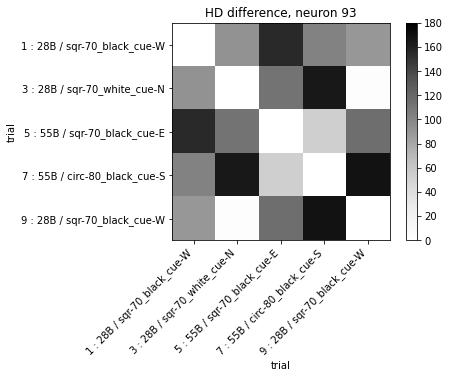

In [36]:
angle_diffs_all = []

for N, (n, ishdcell, hd_angles) in enumerate(zip(cg.neuron_list, hd_cells_, hd_angles_all)):
    if not ishdcell:
        continue
    
    # print(N, n.name, hd_angles)
    
    angle_diffs = angle_diff_matrix(hd_angles)
    angle_diffs_all.append(angle_diffs)
    # print(angle_diffs)
    
    fig, ax = plt.subplots()
    res = plt.imshow(angle_diffs , cmap='Greys', interpolation='none' )
    cb = fig.colorbar(res,ax=ax)
    res.set_clim((0,180))
    plt.xlabel("trial")
    plt.ylabel("trial")

    plt.xticks(range(len(angle_diffs)), trial_labels , rotation=45, ha='right' ) # plt.gca().set_xticks
    plt.yticks(range(len(angle_diffs)), trial_labels)

    plt.title("HD difference, neuron {}".format(n.name))
    plt.show()
    

In [37]:
angle_diffs_mean = np.mean(angle_diffs_all,axis=0)
angle_diffs_std = np.std(angle_diffs_all,axis=0)

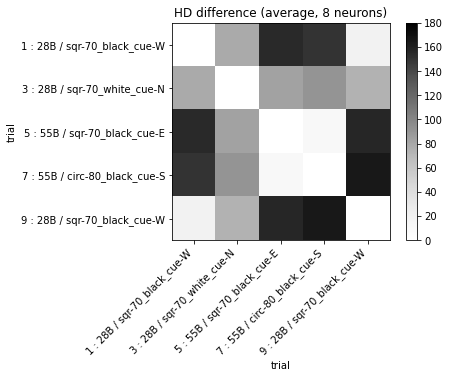

In [38]:
fig, ax = plt.subplots()
res = plt.imshow(angle_diffs_mean , cmap='Greys', interpolation='none' )
cb = fig.colorbar(res,ax=ax)
res.set_clim((0,180))
plt.xlabel("trial")
plt.ylabel("trial")

plt.xticks(range(len(angle_diffs_mean)), trial_labels , rotation=45, ha='right' ) # plt.gca().set_xticks
plt.yticks(range(len(angle_diffs_mean)), trial_labels) 


plt.title("HD difference (average, {} neurons)".format(len(angle_diffs_all)))
plt.show()

In [39]:
for mean,std in zip(angle_diffs_mean[0,1:], angle_diffs_std[0,1:]):
    print(mean,std)

78.67895948260531 10.603561828251777
155.2956955594756 12.71790643689508
150.12891277509246 21.52976415569715
19.35630871907332 28.0952662181066


In [40]:
trial_labels

['1 : 28B / sqr-70_black_cue-W',
 '3 : 28B / sqr-70_white_cue-N',
 '5 : 55B / sqr-70_black_cue-E',
 '7 : 55B / circ-80_black_cue-S',
 '9 : 28B / sqr-70_black_cue-W']

In [41]:
data = np.array(angle_diffs_all)[:,0,1:] # all neurons, first row (compare first trial), with all but first trial
print(data.shape)

(8, 4)


In [42]:
compare_labels = [ trial_labels[0] + " -- " + t for t in trial_labels[1:] ]

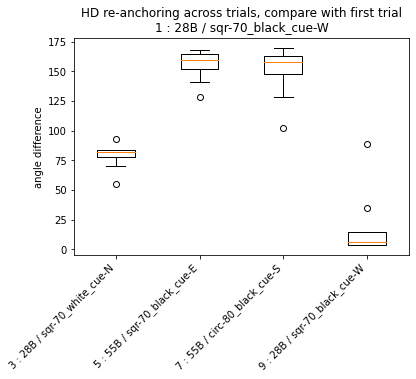

In [43]:
plt.boxplot(data)
plt.xticks(np.arange(1,len(trial_labels)), trial_labels[1:] , rotation=45, ha='right' )
plt.ylabel("angle difference")
plt.title("HD re-anchoring across trials, compare with first trial" + "\n" + trial_labels[0])
plt.show()

### **Grid analysis**

#### map correlation across trials

In [44]:
## Grid Cell detection, defined as := grid cell pattern in first & last trial
# trial_1_and_2 = np.array(grid_cells_all)[:,0:2] # check for grid cells within first two trials
trial_1_and_2 = np.array(grid_cells_all)[:,[0,-1]] # check for grid cells within first and last trials (reference baselines)

In [45]:
grid_cells_ = trial_1_and_2.all(axis=1)
print("Grid cells:", sum(grid_cells_), "out of", len(grid_cells_), "cells")

Grid cells: 2 out of 36 cells


In [46]:
grid_cells_ids = np.where(grid_cells_)[0]
print("grid cell neurons:", grid_cells_ids)
for g in grid_cells_ids:
    print("#",g, ",", "grid cell in trials:",grid_cells_all[g])

grid cell neurons: [25 31]
# 25 , grid cell in trials: [True, True, False, False, True]
# 31 , grid cell in trials: [True, False, False, False, True]


In [47]:
trials_in_environment_shape = [ [t,(shape,diam)] for t,(tn,su,en,(shape,diam,color,cue),ef,iv) in enumerate(session_trials) if t in trials_in_environment ]
print("trials_in_environment_shape:", trials_in_environment_shape)
shape=trials_in_environment_shape[0][1]
print("shape:",shape)
trials_in_environment_same_shape = [ t for t,s in trials_in_environment_shape if s==shape ]
print("trials_in_environment_same_shape:", trials_in_environment_same_shape)

trial_labels = [ str(t+1)+" : "+su+" / "+en for t,(tn,su,en,(shape,diam,color,cue),ef,iv) in enumerate(session_trials) if t in trials_in_environment_same_shape ]
print("trial_labels:", trial_labels)
trials_ids = [ i for i,t in enumerate(trials_in_environment) if t in trials_in_environment_same_shape ]
print("trials_ids:", trials_ids)

trials_in_environment_shape: [[0, ('square', 70.0)], [2, ('square', 70.0)], [4, ('square', 70.0)], [6, ('circle', 80.0)], [8, ('square', 70.0)]]
shape: ('square', 70.0)
trials_in_environment_same_shape: [0, 2, 4, 8]
trial_labels: ['1 : 28B / sqr-70_black_cue-W', '3 : 28B / sqr-70_white_cue-N', '5 : 55B / sqr-70_black_cue-E', '9 : 28B / sqr-70_black_cue-W']
trials_ids: [0, 1, 2, 4]


In [48]:
grid_cell_ids = []

maps_correlation = [] # collect correlation of maps

for N, (n, isgridcell, firing_rate_maps, grid_rotations) in enumerate(zip(cg.neuron_list, grid_cells_, firing_rate_maps_all, grid_rotations_all)):
    if not isgridcell:
        continue
    
    map1 = firing_rate_maps[0]
    mcorr = []
    
    for t,map2 in zip(trials_in_environment, firing_rate_maps):
        if t not in trials_in_environment_same_shape:
            continue
        
        p = n.spatial_properties.map_crosscorrelation(map1=map1, map2=map2)
        mcorr.append(p)

    maps_correlation.append(mcorr)
    
    grid_cell_ids.append(N)

In [49]:
print("grid_cell_ids:", grid_cell_ids)

grid_cell_ids: [25, 31]


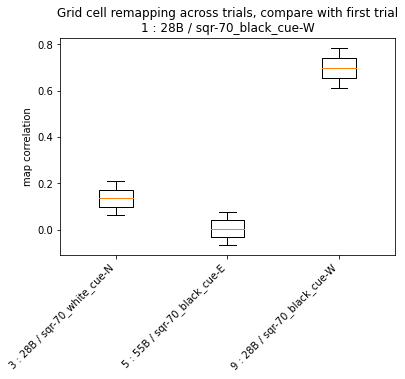

In [50]:
plt.boxplot(np.array(maps_correlation)[:,1:])
plt.xticks(np.arange(1,len(trial_labels)), trial_labels[1:] , rotation=45, ha='right' )
plt.ylabel("map correlation")
plt.title("Grid cell remapping across trials, compare with first trial" + "\n" + trial_labels[0])
plt.show()

#### correlation across cells

In [64]:
from itertools import product

def pairs(a):
    return set(tuple(sorted(t)) for t in product(a,a) if t[0] != t[1])

In [65]:
from scipy import signal
# corr = signal.correlate2d(map1, map2, boundary='symm', mode='same')
# corr = signal.correlate2d(map1, map2)

In [66]:
def argmax2d(a):
    return np.unravel_index(np.argmax(a), a.shape)

* trial 0
25 31


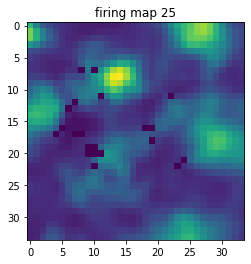

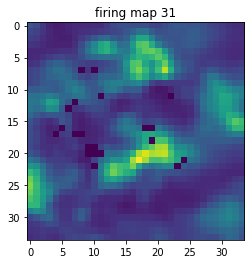

correlate2d (67, 67)
midpoint [33 33]
peak [33 33]
offset [0 0]


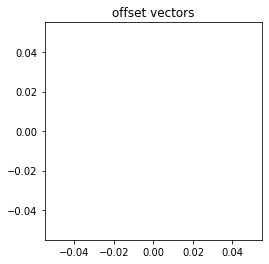


* trial 1
25 31


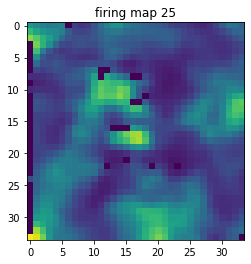

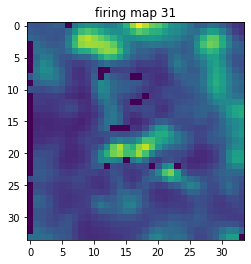

correlate2d (67, 67)
midpoint [33 33]
peak [33 33]
offset [0 0]


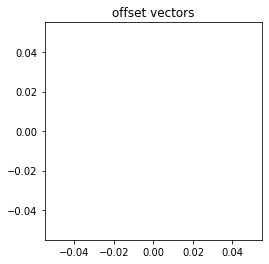


* trial 2
25 31


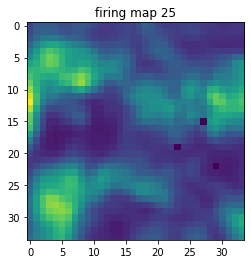

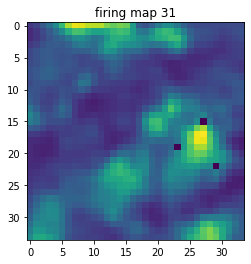

correlate2d (67, 67)
midpoint [33 33]
peak [33 33]
offset [0 0]


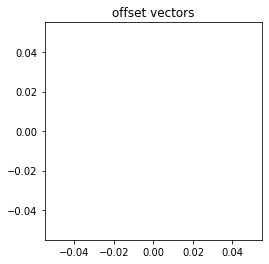


* trial 4
25 31


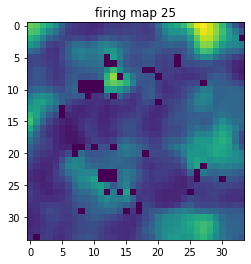

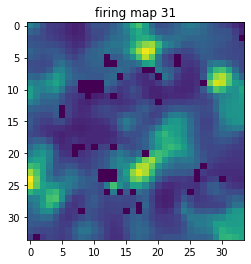

correlate2d (67, 67)
midpoint [33 33]
peak [33 33]
offset [0 0]


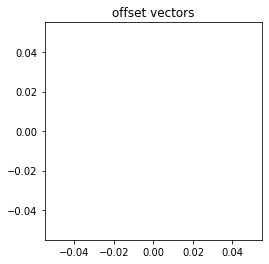

In [72]:
offset_vectors = []

for t in trials_ids:

    print("* trial",t)
    
    offset_vectors_trial = []

    for id1,id2 in pairs(grid_cell_ids):
        print(id1,id2)

    
        f1,f2 = np.array(firing_rate_maps_all,dtype=object)[[id1,id2],t]

        plt.imshow(f1)
        plt.title("firing map "+str(id1))
        plt.show()
        plt.imshow(f2)
        plt.title("firing map "+str(id2))
        plt.show()

        # c = signal.correlate2d(f1,f2, boundary='symm', mode='same')
        c = signal.correlate2d(f1,f2)
        print("correlate2d",c.shape)

        # print(np.min(c),np.max(c))
        # plt.imshow(c)
        # plt.show()

        midpoint = ((np.array(np.shape(c))-1)/2).astype(int)
        print("midpoint",midpoint)
        peak = np.array(argmax2d(c))
        print("peak",peak)
        offset = peak - midpoint

        print("offset",offset)
        
        offset_vectors_trial.append(offset)
        
    
    for offset in offset_vectors_trial:
        plt.plot([0,offset[0]],[0,offset[1]])
    plt.gca().set_aspect('equal', adjustable='box')
    plt.title("offset vectors")
    plt.show()
    
    offset_vectors.append(offset_vectors_trial)
    
    print("")

In [74]:
np.array(offset_vectors).shape # = number of trials , number of grid cell pairs , 2 (2d vector)

(4, 1, 2)

In [56]:
for vectors1,vectors2 in zip(offset_vectors[:-1],offset_vectors[1:]):
    print(vectors1,vectors2)
    deg = find_angle(vectors1,vectors2)
    print(deg)
    print("")

[array([0, 0])] [array([0, 0])]


NameError: name 'find_angle' is not defined

In [62]:
def rotate_by_degree(vec, deg):
    theta = np.radians(deg)
    c, s = np.cos(theta), np.sin(theta)
    R = np.array(((c, -s), (s, c)))
    return np.dot(R, vec)

In [63]:
vectors1 = np.array([[1,0],[0,1]])
vectors2 = np.array([[0,1],[-1,0]])
find_angle(vectors1,vectors2)

89.99999999853176

In [59]:
def error_func(deg, vectors_in,vectors_rotated):
    return np.sum([np.linalg.norm(vector2 - rotate_by_degree(vector1, deg)) for vector1,vector2 in zip(vectors_in,vectors_rotated) ])

In [60]:
def error_func_vectorized(degs, *vectors):
    vectors_in,vectors_rotated = vectors
    return np.array([ error_func(deg, vectors_in,vectors_rotated) for deg in degs ])

In [61]:
from scipy.optimize import minimize

def find_angle(vectors1,vectors2):
    ret = minimize(fun=error_func_vectorized, x0=90.01, bounds=[(0,360)], args=(vectors1,vectors2))
    return ret.x[0]

In [ ]:
trial_rots = [ [ find_angle(vectors1,vectors2) for vectors2 in offset_vectors ] for vectors1 in offset_vectors ]

In [ ]:
fig, ax = plt.subplots()
res = plt.imshow(trial_rots , cmap='Greys', interpolation='none' )
cb = fig.colorbar(res,ax=ax)
res.set_clim((0,360))
plt.xlabel("trial")
plt.ylabel("trial")

plt.xticks(range(len(trial_labels)), trial_labels , rotation=45, ha='right' )
plt.yticks(range(len(trial_labels)), trial_labels) 

plt.title("Grid cells' grid pattern rotation")
plt.show()

In [ ]:
## maps_correlation = [] # collect correlation of maps

for N, (n, isgridcell, firing_rate_maps, grid_rotations) in enumerate(zip(cg.neuron_list, grid_cells_, firing_rate_maps_all, grid_rotations_all)):
    if not isgridcell:
        continue
    
    map1 = firing_rate_maps[0]
    mcorr = []
    
    for t,map2 in zip(trials_in_environment, firing_rate_maps):
        if t not in trials_in_environment_same_shape:
            continue
        
        p = n.spatial_properties.map_crosscorrelation(map1=map1, map2=map2)
        mcorr.append(p)

    maps_correlation.append(mcorr)

In [192]:
grid_cell_ids

[25, 37, 41]

In [92]:
from scipy import signal
# corr = signal.correlate2d(map1, map2, boundary='symm', mode='same')
corr = signal.correlate2d(map1, map2)

NameError: name 'map1' is not defined

In [53]:
map_crosscorrelation

NameError: name 'map_crosscorrelation' is not defined

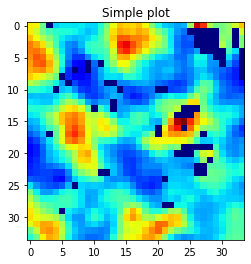

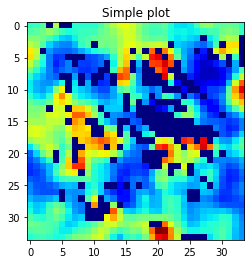

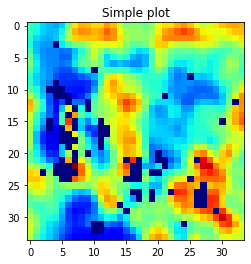

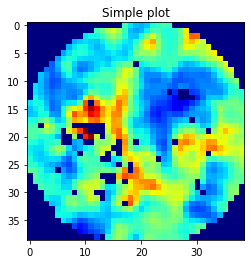

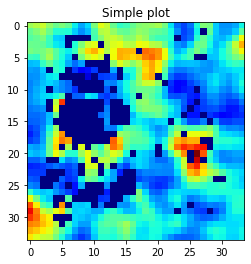

In [74]:
for f in firing_rate_maps:
    #plt.imshow(f)
    #plt.show()
    
    fig, ax = plt.subplots()
    im=ax.imshow(f.T, cmap='jet')
    ax.set_title('Simple plot')
    plt.show()
    

In [86]:
n.spatial_properties.map_crosscorrelation(map1=firing_rate_maps[0],map2=firing_rate_maps[4])

0.19532718376090952

In [87]:
map1 = firing_rate_maps[0]
for map2 in firing_rate_maps[1:]:
    if (map1.shape == map2.shape):
        r = n.spatial_properties.map_crosscorrelation(map1=map1,map2=map2)
        print("r=",r)

r= -0.1038388260532766
r= -0.09212528481627352
r= 0.19532718376090952


In [103]:
map_correlations = [ [ n.spatial_properties.map_crosscorrelation(map1=map1,map2=map2) for map1 in firing_rate_maps if (map1.shape == map2.shape) ] for map2 in firing_rate_maps ]

In [107]:
map_correlations

[[0.9999999999999998,
  0.25248051861431636,
  -0.29629276053222436,
  0.34722454424575755],
 [0.25248051861431636,
  0.9999999999999999,
  -0.20177359591042393,
  0.2614614680596584],
 [-0.29629276053222436, -0.20177359591042393, 1.0, -0.2140040282178787],
 [0.9999999999999999],
 [0.34722454424575755, 0.2614614680596584, -0.2140040282178787, 1.0]]

In [117]:
grid_rotations_deg = np.array(grid_rotations)*180/np.pi

In [ ]:
angle_diff(hexrot1,hexrot2, 60)

(5, 5) [[ 0.         12.12121212  8.48484848 14.54545455  6.06060606]
 [12.12121212  0.          3.63636364  2.42424242  6.06060606]
 [ 8.48484848  3.63636364  0.          6.06060606  2.42424242]
 [14.54545455  2.42424242  6.06060606  0.          8.48484848]
 [ 6.06060606  6.06060606  2.42424242  8.48484848  0.        ]]


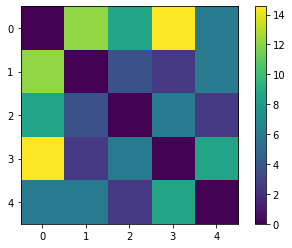

In [118]:
grid_rot_diffs = angle_diff_matrix(grid_rotations_deg, 60)
print(grid_rot_diffs.shape, grid_rot_diffs)
plt.imshow(grid_rot_diffs)
plt.colorbar()

NameError: name 'grid_rot_diffs' is not defined

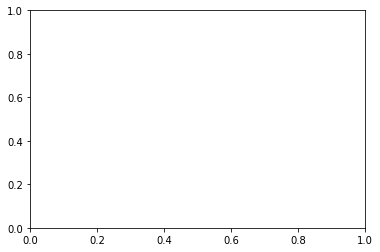

In [31]:
fig, ax = plt.subplots()
res = plt.imshow(grid_rot_diffs , cmap='Greys', interpolation='none' )
cb = fig.colorbar(res,ax=ax)
res.set_clim((0,30))
plt.xlabel("trial")
plt.ylabel("trial")

plt.xticks(range(len(grid_rot_diffs)), trial_labels , rotation=45, ha='right' ) # plt.gca().set_xticks
plt.yticks(range(len(grid_rot_diffs)), trial_labels) 


plt.title("hexagonal grid rotation difference")
plt.show()

In [79]:
np.isnan(n.spatial_properties.firing_rate_map)

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [80]:
np.sum(np.isnan(n.spatial_properties.firing_rate_map))

0

In [77]:
np.sum(n.spatial_properties.firing_rate_map==-1)

183

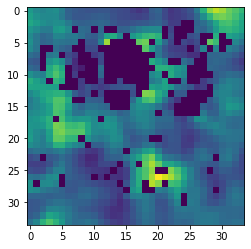

In [78]:
plt.imshow(n.spatial_properties.firing_rate_map)

## For each Trial, individual analysis

hd_mean_direction_rad, hd_mean_direction_deg, hd_mean_vector_length -0.5883400044093717 -33.70939917136524 0.16641014086012215


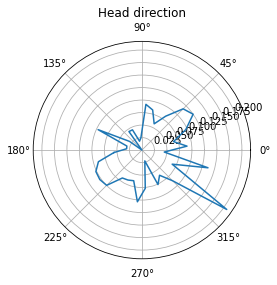

In [46]:
## demo execution for one neuron

# polar plot
n = cg.neuron_list[1]
n.set_spatial_properties(ap)
n.spatial_properties.firing_rate_head_direction_histogram(smoothing=False)

angles = n.spatial_properties.mid_point_from_edges(n.spatial_properties.firing_rate_head_direction_histo_edges)
hd_firing = n.spatial_properties.firing_rate_head_direction_histo

hd_mean_direction_rad, hd_mean_direction_deg, hd_mean_vector_length, hd_peak_angle_rad, hd_peak_rate = n.spatial_properties.head_direction_score()

#print("angles:",len(angles),angles)
#print("hd_firing:",len(data),data)

print("hd_mean_direction_rad, hd_mean_direction_deg, hd_mean_vector_length",hd_mean_direction_rad, hd_mean_direction_deg, hd_mean_vector_length)

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
#ax.plot(angles, data)
ax.plot(np.append(angles,angles[0]), np.append(hd_firing,hd_firing[0]))
ax.grid(True)
#ax.axvline(hd_mean_direction_rad, hd_mean_vector_length, color="black")
ax.set_title("Head direction")
plt.show()

compare between trials

Trial 0 (pk3865-01022022_01)
environment: sqr-70_black_cue-W
Interval: [[   0.      1467.28795]]


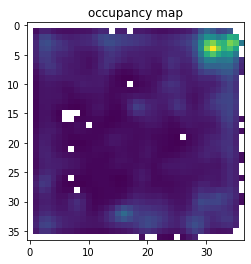

occupancy map <class 'numpy.ndarray'> (37, 37)
xy_range [[ 11.51887004  32.22531227]
 [ 81.51887004 102.22531227]]


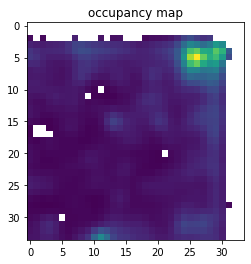

occupancy map <class 'numpy.ndarray'> (34, 34)


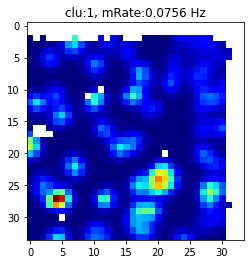

firingrate map <class 'numpy.ndarray'> (34, 34)



In [47]:
#break

for i,(tn,iv,en) in enumerate(zip(ses.trial_names, ses.trial_intervals.inter, ses.desen)):
    
    if en=="rb":
        continue
    
    print("Trial",i,"("+tn+")") 
    print("environment:",en)
    
    iv=np.array([iv])
    print("Interval:",iv)

    # reset and set intervals
    n.spike_train.unset_intervals()
    ap.unset_intervals()
    n.spike_train.set_intervals(iv)
    ap.set_intervals(iv)
    n.set_spatial_properties(ap)
    
    # occupancy map
    ap.occupancy_map_2d()
    plt.imshow(ap.occupancy_map)
    plt.title("occupancy map")
    plt.gca().set_aspect('equal', adjustable='box')
    #plt.gca().axis('equal')
    plt.show()
    print("occupancy map",type(ap.occupancy_map),ap.occupancy_map.shape)
    
    
    #xy_range = np.array([[0,0],[70,70]]) # [[xmin,ymin],[xmax,ymax]]
    xy_range = ap.invalid_outside_spatial_area(shape = "square", length=70)
    print("xy_range",xy_range)
    ap.occupancy_map_2d(xy_range=xy_range)
    plt.imshow(ap.occupancy_map)
    plt.title("occupancy map")
    plt.gca().set_aspect('equal', adjustable='box')
    #plt.gca().axis('equal')
    plt.show()
    print("occupancy map",type(ap.occupancy_map),ap.occupancy_map.shape)
    
    # spatial firing map 
    #n.spatial_properties.firing_rate_map_2d(cm_per_bin =2, smoothing_sigma_cm = 2, smoothing=True)
    n.spatial_properties.firing_rate_map_2d(xy_range=xy_range)
    plt.imshow(n.spatial_properties.firing_rate_map,cmap='jet')
    plt.title("clu:{}, mRate:{:.3} Hz".format(n.name,n.spike_train.mean_firing_rate()))
    plt.show()
    print("firingrate map",type(n.spatial_properties.firing_rate_map),n.spatial_properties.firing_rate_map.shape)
   
    print("")


In [48]:
ses.n_trials

1

In [45]:
ses.n_trials
trials_environments = [ en for en in ses.desen if not en=="rb" ]

In [46]:
trials_environments

['sqr-70_black_cue-W',
 'sqr-70_white_cue-N',
 'sqr-70_black_cue-E',
 'circ-80_black_cue-S',
 'sqr-70_black_cue-W']

In [52]:
name

'pk3865-01022022-0101'

In [ ]:
#squeeze=False
fig, axs = plt.subplots(len(cg.neuron_list), len(trials_environments), figsize=(20, 5*len(cg.neuron_list)), constrained_layout = True , squeeze=False)

for i, n in enumerate(cg.neuron_list):
    
    n.set_spatial_properties(ap)
    
    j=0
    
    for t,(tn,iv,en,su,ef) in enumerate(zip(ses.trial_names, ses.trial_intervals.inter, ses.desen, ses.setup, ses.environmentFamiliarity)):
        
        if en=="rb":
            continue

        iv=np.array([iv])

        # reset and set intervals        
        n.spike_train.unset_intervals()
        ap.unset_intervals()
        n.spike_train.set_intervals(iv)
        ap.set_intervals(iv)

        # spatial firing map
        #xy_range = n.spatial_properties.ap.invalid_outside_spatial_area(shape = "square", length=70)
        n.spatial_properties.firing_rate_map_2d(cm_per_bin =2, smoothing_sigma_cm = 2, smoothing=True)
        #n.spatial_properties.firing_rate_map_2d(xy_range = xy_range)


        
        axs[i,j].imshow(n.spatial_properties.firing_rate_map,cmap='jet')
        gs=n.spatial_properties.grid_score()
        
        fw='bold' if gs>.4 else 'normal'
            
        axs[i,j].set_title("clu:{}, mRate:{:.3} Hz\ngrid score:{:.3}".format(n.name,n.spike_train.mean_firing_rate(),gs) + "\n" + "Trial "+str(t+1)+" ("+tn+")"+"\n"+"setup: "+su+"\n"+"environment: "+en+"\n"+"familiarity: "+ef, fontweight=fw)
        axs[i,j].set_aspect('equal', adjustable='box')
        j+=1
        
    # testing
    if i>2:
        break

#plt.tight_layout()
#fig.subplots_adjust(wspace=0.1, hspace=0.85)
#plt.savefig(prefixdir+'/home/pascal/Documents/science_docs/analysis_results/'+name+'_trials.pdf')
plt.show()


In [ ]:
fig, axs = plt.subplots(len(cg.neuron_list), len(trials_environments), figsize=(20, 5*len(cg.neuron_list)), constrained_layout = True)

for i, n in enumerate(cg.neuron_list):
    
    n.set_spatial_properties(ap)
    
    j=0
    
    for t,(tn,iv,en,su,ef) in enumerate(zip(ses.trial_names, ses.trial_intervals.inter, ses.desen, ses.setup, ses.environmentFamiliarity)):
        
        if en=="rb":
            continue

        iv=np.array([iv])

        # reset and set intervals        
        n.spike_train.unset_intervals()
        ap.unset_intervals()
        n.spike_train.set_intervals(iv)
        ap.set_intervals(iv)

        
        
        # Head direction

        n.spatial_properties.firing_rate_head_direction_histogram(smoothing=False)

        angles = n.spatial_properties.mid_point_from_edges(n.spatial_properties.firing_rate_head_direction_histo_edges)
        hd_firing = n.spatial_properties.firing_rate_head_direction_histo
        hd_mean_direction_rad, hd_mean_direction_deg, hd_mean_vector_length, hd_peak_angle_rad, hd_peak_rate = n.spatial_properties.head_direction_score()

        axs[i,j].plot(angles, hd_firing)
        axs[i,j].set_xlabel("Head direction")
        axs[i,j].set_ylabel("Firing rate (Hz)")
        axs[i,j].set_ylim(0,np.max(n.spatial_properties.firing_rate_head_direction_histo)*1.2)
        axs[i,j].axvline(x=hd_mean_direction_rad, color="black")
        axs[i,j].axvline(x=hd_peak_angle_rad, color="black", ls="dashed")
        #axs[i,4].text(s=str(round(hd_mean_direction_rad*180./np.pi))+" ° (vector length = "+str(hd_mean_vector_length)+")",x=hd_mean+.1,y=1)
        
        
        fw='bold' if (hd_mean_vector_length>.4 and hd_peak_rate>3) else 'normal' # check for vector len AND peak rate
            
        #axs[i,j].set_title("clu:{}, mRate:{:.3} Hz\ngrid score:{:.3}".format(n.name,n.spike_train.mean_firing_rate(),gs) + "\n" + "Trial "+str(t+1)+" ("+tn+")"+"\n"+"setup: "+su+"\n"+"environment: "+en+"\n"+"familiarity: "+ef, fontweight=fw)
        #axs[i,j].set_aspect('equal', adjustable='box')
        if (np.isfinite(hd_mean_direction_deg) and np.isfinite(hd_mean_vector_length)):
            axs[i,j].set_title("neuron "+n.name+"\n"+"Head direction" + "\n" + "mean direction: " + str(round( (hd_mean_direction_deg + 360) % 360  )) +"°" + "\n" + "mean vector length: " + str(np.round(hd_mean_vector_length,2))  , fontweight=fw)
        else:
            axs[i,j].set_title("?")
        j+=1
        
    # testing
    #if i>2:
    #    break

#plt.tight_layout()
#fig.subplots_adjust(wspace=0.1, hspace=0.85)
plt.savefig('/home/pascal/Documents/science_docs/analysis_results/'+name+'_trials_hd.pdf')
plt.show()


In [ ]:
# grid cells: .any / .all - axis=0, per trial (cells must show grid pattern in all trials!),   same for classify HD cells

In [ ]:
# map correlation - grid score

print("map correlation")

maps_correlation = [] # collect correlation of maps

for i, n in enumerate(cg.neuron_list):
    
    print("=====================")
    print(i,n.name)
    print("")
    
    n.set_spatial_properties(ap)    
    maps=[] # maps to compare with
    
    for t,(tn,iv,en) in enumerate(zip(ses.trial_names, ses.trial_intervals.inter, ses.desen)):

        if en=="rb":
            continue
            
        print("Trial",t+1,"("+tn+")")
        print("environment:",en)
        iv=np.array([iv])
        print("Interval:",iv)
        
        # reset and set intervals
        n.spike_train.unset_intervals()
        ap.unset_intervals()
        n.spike_train.set_intervals(iv)
        ap.set_intervals(iv)
        
        xy_range = n.spatial_properties.ap.invalid_outside_spatial_area(shape = "square", length=70)
        print("xy_range",xy_range)
        #n.spatial_properties.firing_rate_map_2d(cm_per_bin =2, smoothing_sigma_cm = 2, smoothing=True)
        n.spatial_properties.firing_rate_map_2d(xy_range = xy_range)
        
        firing_rate_map = n.spatial_properties.firing_rate_map
        
        if t==0:
            map1 = firing_rate_map
        else:
            maps.append(firing_rate_map)
        
        print("")
        
    
    print("---")
    
    mcorr=[] # for this neuron
    
    for map2 in maps:
        print("map1",map1.shape)
        plt.imshow(map1)
        plt.title("map1")
        plt.show()
        print("map2",map2.shape)
        plt.imshow(map2)
        plt.title("map2")
        plt.show()
        p = n.spatial_properties.map_crosscorrelation(map1=map1, map2=map2)
        print("p=",p)
        mcorr.append(p)
        
    maps_correlation.append(mcorr)
        
    print("===")
        
    #testing
    if i>2:
        break

In [ ]:
maps_correlation = np.array(maps_correlation)
print(maps_correlation.shape)

In [ ]:
maps_correlation

In [107]:
plt.boxplot(maps_correlation)
plt.xticks([1, 2], ['black-white', 'black-black'])
plt.show()

NameError: name 'maps_correlation' is not defined